## Load and Dataset initial Inspection

In [182]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

### First look at the model and scene images into the dataset

Read the image from file.
- image_model: reference book (model)
- image_scenes: shelf of library with books (scene)

Image Model -- dtype: uint8, shape: (747, 66, 3)
Image Scenes -- dtype: uint8, shape: (640, 640, 3)


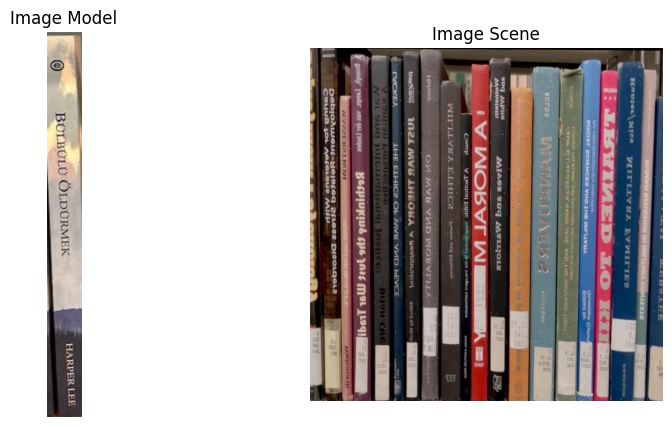

In [183]:
image_model = cv2.imread("./dataset/models/model_0.png")
image_scenes = cv2.imread("./dataset/scenes/scene_0.jpg")

#print datatype and shape of images
print(f"Image Model -- dtype: {image_model.dtype}, shape: {image_model.shape}")
print(f"Image Scenes -- dtype: {image_scenes.dtype}, shape: {image_scenes.shape}")

# show model and scene side by side (use RGB versions for correct colors)
fig, ax = plt.subplots(1, 2, figsize=(10, 5))
ax[0].imshow(cv2.cvtColor(image_model, cv2.COLOR_BGR2RGB))
ax[0].set_title("Image Model")
ax[0].axis("off")

ax[1].imshow(cv2.cvtColor(image_scenes, cv2.COLOR_BGR2RGB))
ax[1].set_title("Image Scene")
ax[1].axis("off")

plt.show()


### Gray scale of the images 

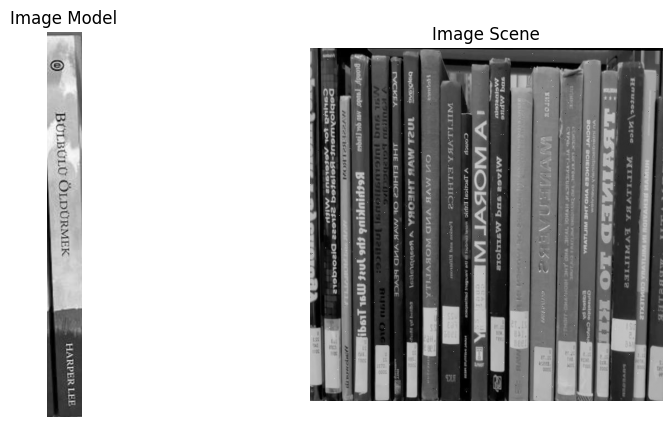

In [184]:
# show model and scene side by side in grayscale
fig, ax = plt.subplots(1, 2, figsize=(10, 5))
ax[0].imshow(cv2.cvtColor(image_model, cv2.COLOR_BGR2GRAY), cmap='gray')
ax[0].set_title("Image Model")
ax[0].axis("off")

ax[1].imshow(cv2.cvtColor(image_scenes, cv2.COLOR_BGR2GRAY), cmap='gray')
ax[1].set_title("Image Scene")
ax[1].axis("off")

plt.show()


### Pixel Access Example

Image Model -- Height: 747, Width: 66, Channels: 3
Pixel RGB value at center (373,33): [ 97 101 111]


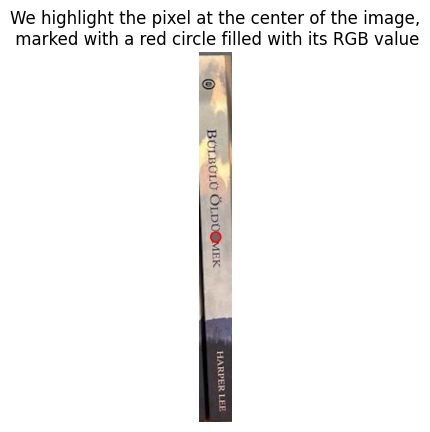

In [185]:
H, W, C = image_model.shape
print(f"Image Model -- Height: {H}, Width: {W}, Channels: {C}")

# pixel al centro dell'immagine
y = H // 2
x = W // 2

pixel_value = image_model[y, x]
print(f"Pixel RGB value at center ({y},{x}): {pixel_value}")

# cerchio che evidenza il pixel
image_copy = image_model.copy()
cv2.circle(image_copy, (x, y), 10, pixel_value.tolist(), -1)
# Plot a slightly larger circle outline for better visibility
cv2.circle(image_copy, (x, y), 10, (0, 0, 255), 2)
plt.imshow(cv2.cvtColor(image_copy, cv2.COLOR_BGR2RGB))

plt.title("We highlight the pixel at the center of the image,\n marked with a red circle filled with its RGB value")
plt.axis('off')
plt.show()


### Preprocessing Filtering

In [186]:
#conversione in scala di grigi

def convert_to_grayscale(img):
    return cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

def get_filter(filter_type="gaussian", **params):
    """
    Ritorna una funzione che applica il filtro voluto su un'immagine (numpy array).
    Supported: "gaussian", "bilateral", "median", "mean", None/"none"
    Params specifici:
        - gaussian: ksize=(5,5), sigma=1
        - bilateral: d=9, sigma_color=75, sigma_space=75
        - median: ksize=5  (deve essere dispari >=3)
        - mean: ksize=5
        - laplacian: ksize=3, scale=1, delta=0
        - sobel: dx=1, dy=0, ksize=3, scale=1, delta=0
    """
    if filter_type is None or filter_type == "none":
        return lambda img: img

    if filter_type == "gaussian":
        k = params.get("ksize", (5, 5))
        sigma = params.get("sigma", 1)
        return lambda img: cv2.GaussianBlur(img, k, sigma)

    if filter_type == "bilateral":
        d = params.get("d", 9)
        sc = params.get("sigma_color", 75)
        ss = params.get("sigma_space", 75)
        return lambda img: cv2.bilateralFilter(img, d, sc, ss)

    if filter_type == "median":
        k = int(params.get("ksize", 5))
        if k % 2 == 0:
            k += 1
        k = max(3, k)
        return lambda img: cv2.medianBlur(img, k)

    if filter_type == "mean":
        k = int(params.get("ksize", 5))
        k = max(1, k)
        kernel = np.ones((k, k), np.float32) / (k * k)
        return lambda img: cv2.filter2D(img, -1, kernel)
    

    # Edge detection filters - require grayscale conversion
    
    if filter_type == "laplacian":
        ksize = int(params.get("ksize", 3))
        scale = params.get("scale", 1)
        delta = params.get("delta", 0)
        return lambda img: cv2.Laplacian(img, cv2.CV_64F, ksize=ksize, scale=scale, delta=delta)
    
    if filter_type == "sobel":
        ksize = int(params.get("ksize", 3))
        scale = params.get("scale", 1)
        delta = params.get("delta", 0)
        
        def sobel_filter(img):
            grad_x = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=ksize, scale=scale, delta=delta)
            grad_y = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=ksize, scale=scale, delta=delta)
            gradient_magnitude = cv2.magnitude(grad_x, grad_y)
            sobel_norm = cv2.convertScaleAbs(gradient_magnitude)
            return sobel_norm
        
        return sobel_filter
        
    if filter_type == "sobel_blend":
        ksize = int(params.get("ksize", 3))
        scale = params.get("scale", 1)
        delta = params.get("delta", 0)
        alpha, betha = 0.7, 0.3

        def sobel_blend(img):
            grad_x = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=ksize, scale=scale, delta=delta)
            grad_y = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=ksize, scale=scale, delta=delta)
            gradient_magnitude = cv2.magnitude(grad_x, grad_y)
            sobel_norm = cv2.convertScaleAbs(gradient_magnitude)
            blended = cv2.addWeighted(img, alpha, sobel_norm, betha, 0)
            return blended
        
        return sobel_blend
    
        
    raise ValueError(f"Unknown filter_type: {filter_type}")


def preprocess_image(img, scale=1.0, filter_type="gaussian", filter_func=None, filter_params=None):
    """
    Ridimensiona e applica il filtro (usa una filter factory o filter_type+filter_params).
    Restituisce (image_filtered, scale) per compatibilità con il codice esistente.
    """
    h, w = img.shape[:2]
    if scale != 1.0:
        img_resized = cv2.resize(img, (int(w * scale), int(h * scale)), interpolation=cv2.INTER_AREA)
    else:
        img_resized = img.copy()

    if filter_func is None:
        filter_func = get_filter(filter_type, **(filter_params or {}))

    img_filtered = filter_func(img_resized)
    return img_filtered

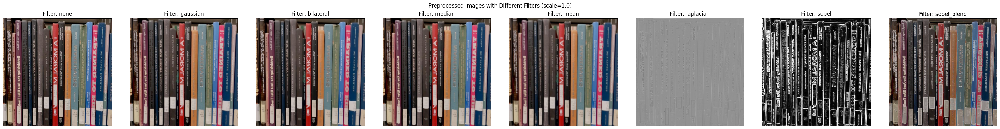

In [187]:
filters = [None, "gaussian", "bilateral", "median", "mean", "laplacian", "sobel", "sobel_blend"]

n = len(filters)
fig, axes = plt.subplots(1, n, figsize=(4 * n, 4), constrained_layout=True)
for i, ftype in enumerate(filters):
    image_input = cv2.cvtColor(image_scenes, cv2.COLOR_BGR2RGB) if ftype not in ["laplacian", "sobel"] else convert_to_grayscale(cv2.cvtColor(image_scenes, cv2.COLOR_BGR2RGB))
    preprocessed_image = preprocess_image(image_input, filter_type=ftype)
    title = "none" if ftype is None else ftype
    ax = axes[i] if n > 1 else axes
    ax.imshow(preprocessed_image, cmap='gray' if ftype in ["laplacian", "sobel"] else None)
    ax.set_title(f"Filter: {title}")
    ax.axis("off")

plt.suptitle(f"Preprocessed Images with Different Filters (scale=1.0)")
plt.show()

### Canny Edge Detection

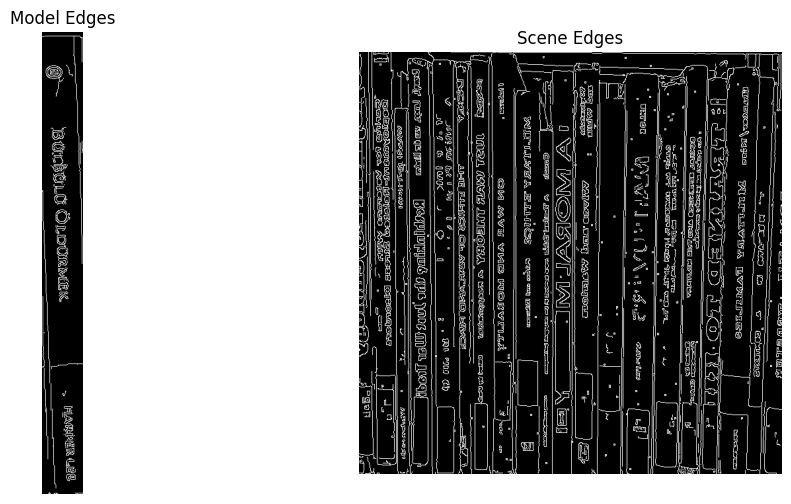

In [188]:

def edge_detection(img, threshold1=100, threshold2=200):
    return cv2.Canny(img, threshold1, threshold2)


plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
plt.imshow(edge_detection(image_model), cmap='gray')
plt.title("Model Edges")
plt.axis("off")
plt.subplot(1,2,2)
plt.imshow(edge_detection(image_scenes), cmap='gray')
plt.title("Scene Edges")
plt.axis("off")
plt.show()

### From web idea:

Apply in order a bilateral filter to reduce noise while keeping edges sharp, followed by a sobel filter to detect edges and finally a canny edge detector to get the final edges.

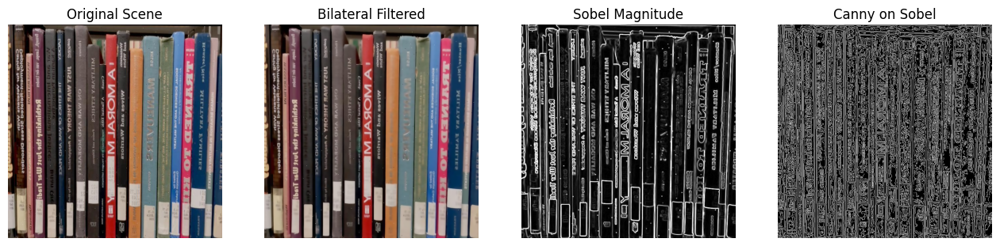

In [189]:
# Bilateral -> Sobel -> Canny pipeline (uses existing cv2, np, plt variables)

def bilat_sobel_canny(img_bgr, d=9, sigma_color=75, sigma_space=75, sobel_ksize=3, canny_thresh1=None, canny_thresh2=None):
    """
    Apply in order:
      1) bilateral filter on BGR image
      2) Sobel edge magnitude on the filtered grayscale image
      3) Canny on the Sobel magnitude (auto thresholds if not provided)
    Returns (bilateral_bgr, sobel_uint8, canny_edges_uint8)
    """
    # 1) bilateral filter (works on BGR)
    bilat = get_filter("bilateral", d=d, sigma_color=sigma_color, sigma_space=sigma_space)(img_bgr)

    # 2) grayscale + sobel magnitude
    gray_bilat = cv2.cvtColor(bilat, cv2.COLOR_BGR2GRAY)
    sx = get_filter("sobel", dx=1, dy=0, ksize=sobel_ksize)(gray_bilat)
    sy = get_filter("sobel", dx=0, dy=1, ksize=sobel_ksize)(gray_bilat)
    sobel_mag = np.hypot(sx, sy)
    # normalize to 0-255 uint8
    if sobel_mag.max() > 0:
        sobel_u8 = np.uint8(255.0 * (sobel_mag / sobel_mag.max()))
    else:
        sobel_u8 = np.uint8(sobel_mag)

    # 3) Canny on sobel result; auto thresholds if not provided
    if canny_thresh1 is None or canny_thresh2 is None:
        v = np.median(sobel_u8)
        sigma = 0.33
        t1 = int(max(0, (1.0 - sigma) * v))
        t2 = int(min(255, (1.0 + sigma) * v))
    else:
        t1, t2 = int(canny_thresh1), int(canny_thresh2)

    edges = cv2.Canny(sobel_u8, t1, t2)

    return bilat, sobel_u8, edges

# Run pipeline on the existing scene image and show results
bilat_img, sobel_img, canny_edges = bilat_sobel_canny(image_scenes, d=9, sigma_color=75, sigma_space=75, sobel_ksize=3, canny_thresh1=None, canny_thresh2=200)

plt.figure(figsize=(16,5))
plt.subplot(1,4,1)
plt.imshow(cv2.cvtColor(image_scenes, cv2.COLOR_BGR2RGB))
plt.title("Original Scene")
plt.axis("off")

plt.subplot(1,4,2)
plt.imshow(cv2.cvtColor(bilat_img, cv2.COLOR_BGR2RGB))
plt.title("Bilateral Filtered")
plt.axis("off")

plt.subplot(1,4,3)
plt.imshow(sobel_img, cmap="gray")
plt.title("Sobel Magnitude")
plt.axis("off")

plt.subplot(1,4,4)
plt.imshow(canny_edges, cmap="gray")
plt.title("Canny on Sobel")
plt.axis("off")

plt.show()

### SIFT Keypoint Detection and Description

In [190]:
# SIFT
def extract_sift_features(gray_img, nfeatures=50000):
    """
    Estrai keypoints e descrittori SIFT
    """
    # SIFT con limite di features (performance)
    sift = cv2.SIFT_create(nfeatures=nfeatures)
    
    # Detect + Compute in un colpo solo
    keypoints, descriptors = sift.detectAndCompute(gray_img, None)
    
    return keypoints, descriptors

In [191]:
# Test sift extraction on different pipelines
pipelines = {
    "Original Grayscale": lambda img: convert_to_grayscale(img),
    "Bilateral": lambda img: preprocess_image(img, filter_type="bilateral"),
    "Gaussian": lambda img: preprocess_image(img, filter_type="gaussian"),
    "Median": lambda img: preprocess_image(img, filter_type="median"),
    "Sobel": lambda img: preprocess_image(img, filter_type="sobel"),
    "Sobel Blend": lambda img: preprocess_image(img, filter_type="sobel_blend"),
    "Bilateral + Sobel Blend": lambda img: preprocess_image(get_filter("bilateral")(img), filter_type="sobel_blend")
}

for name, pipeline_func in pipelines.items():
    # Preprocess image
    preprocessed_img = pipeline_func(image_model)
    
    # Ensure grayscale for SIFT
    if len(preprocessed_img.shape) == 3:
        gray_img = convert_to_grayscale(preprocessed_img)
    else:
        gray_img = preprocessed_img
    
    # Extract SIFT features
    keypoints, descriptors = extract_sift_features(gray_img)
    
    print(f"Pipeline: {name}")
    print(f"  Number of Keypoints: {len(keypoints)}")
    print(f"  Descriptors shape: {descriptors.shape if descriptors is not None else 'None'}")
    print()

Pipeline: Original Grayscale
  Number of Keypoints: 391
  Descriptors shape: (391, 128)

Pipeline: Bilateral
  Number of Keypoints: 277
  Descriptors shape: (277, 128)

Pipeline: Gaussian
  Number of Keypoints: 301
  Descriptors shape: (301, 128)

Pipeline: Median
  Number of Keypoints: 196
  Descriptors shape: (196, 128)

Pipeline: Sobel
  Number of Keypoints: 428
  Descriptors shape: (428, 128)

Pipeline: Sobel Blend
  Number of Keypoints: 229
  Descriptors shape: (229, 128)

Pipeline: Bilateral + Sobel Blend
  Number of Keypoints: 141
  Descriptors shape: (141, 128)



### CLAHE Histogram Equalization

In [192]:
def clahe_equalization(img, clip_limit=2.0, tile_grid_size=(8,8)):
    """
    Applica CLAHE (Contrast Limited Adaptive Histogram Equalization) su un'immagine in scala di grigi.
    """
    clahe = cv2.createCLAHE(clipLimit=clip_limit, tileGridSize=tile_grid_size)
    img_clahe = clahe.apply(img)
    return img_clahe

In [193]:
for name, pipeline_func in pipelines.items():
    # Preprocess image
    preprocessed_img = pipeline_func(image_model)
    
    # Ensure grayscale for SIFT
    if len(preprocessed_img.shape) == 3:
        gray_img = convert_to_grayscale(preprocessed_img)
    else:
        gray_img = preprocessed_img

    # CLAHE requires a single-channel uint8 image.
    # Some filters may produce other dtypes; force uint8 before CLAHE.
    gray_uint8 = gray_img.astype(np.uint8)
    
    # Apply CLAHE to enhance contrast (use the grayscale uint8 image)
    clahe_img = clahe_equalization(gray_uint8)
    
    # Extract SIFT features from the CLAHE image (better contrast)
    keypoints, descriptors = extract_sift_features(clahe_img)
    
    print(f"Pipeline: {name}")
    print(f"  Number of Keypoints: {len(keypoints)}")
    print(f"  Descriptors shape: {descriptors.shape if descriptors is not None else 'None'}")
    print()

Pipeline: Original Grayscale
  Number of Keypoints: 582
  Descriptors shape: (582, 128)

Pipeline: Bilateral
  Number of Keypoints: 349
  Descriptors shape: (349, 128)

Pipeline: Gaussian
  Number of Keypoints: 421
  Descriptors shape: (421, 128)

Pipeline: Median
  Number of Keypoints: 297
  Descriptors shape: (297, 128)

Pipeline: Sobel
  Number of Keypoints: 697
  Descriptors shape: (697, 128)

Pipeline: Sobel Blend
  Number of Keypoints: 482
  Descriptors shape: (482, 128)

Pipeline: Bilateral + Sobel Blend
  Number of Keypoints: 239
  Descriptors shape: (239, 128)



In [194]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from collections import defaultdict
import pandas as pd

# Filtri da testare
filters_config = {
    "Original Grayscale": {
        "func": lambda img: convert_to_grayscale(img),
        "description": "No filter, direct grayscale"
    },
    "Bilateral": {
        "func": lambda img: convert_to_grayscale(get_filter("bilateral")(img)),
        "description": "Bilateral filter (d=9, σ_color=75, σ_space=75)"
    },
    "Gaussian": {
        "func": lambda img: convert_to_grayscale(get_filter("gaussian")(img)),
        "description": "Gaussian blur (kernel=5x5, σ=1)"
    },
    "Sobel Blend": {
        "func": lambda img: convert_to_grayscale(get_filter("sobel_blend", ksize=3)(img)),
        "description": "Sobel blended with original (ksize=3)"
    },
    "Grayscale + CLAHE" : {
        "func": lambda img: clahe_equalization(
            convert_to_grayscale(img)
        ),
        "description": "CLAHE histogram equalization"
    },
    "Gaussian + CLAHE": {
        "func": lambda img: clahe_equalization(
            convert_to_grayscale(get_filter("gaussian")(img))
        ),
        "description": "Gaussian + CLAHE histogram equalization"
    },
    "Bilateral + CLAHE": {
        "func": lambda img: clahe_equalization(
            convert_to_grayscale(get_filter("bilateral")(img))
        ),
        "description": "Bilateral + CLAHE histogram equalization"
    },
    "Sobel Blend + CLAHE": {
        "func": lambda img: clahe_equalization(
            convert_to_grayscale(get_filter("sobel_blend", ksize=3)(img))
        ),
        "description": "cv2.Sobel blended + CLAHE histogram equalization"
    },
    "Bilateral + Sobel Blend + CLAHE": {
        "func": lambda img: clahe_equalization(
            convert_to_grayscale(get_filter("sobel_blend", ksize=3)(
                get_filter("bilateral")(img)
            ))
        ),
        "description": "Bilateral + Sobel Blend + CLAHE histogram equalization"
    }
}

In [195]:


def analyze_filters_on_dataset(models_path="./dataset/models", 
                                scenes_path="./dataset/scenes",
                                max_dim=1000):
    """
    Analizza l'impatto di diversi filtri su tutte le scene del dataset.
    
    Returns:
        DataFrame con statistiche per ogni filtro
    """
    
    
    valid_exts = [".png", ".jpg", ".jpeg", ".bmp"]
    
    # Struttura per salvare risultati
    results = defaultdict(lambda: {
        'keypoints_per_image': [],
        'descriptor_stats': [],              # 🆕 Statistiche descrittori
        'total_keypoints': 0,
        'num_images': 0,
        'min_keypoints': float('inf'),
        'max_keypoints': 0,
        'scene_stats': defaultdict(lambda: {
            'keypoints': [], 
            'descriptor_mean': [],           # 🆕
            'descriptor_variance': [],       # 🆕
            'descriptor_entropy': []         # 🆕
        })
    })
    
    
    # Carica tutte le scene
    scene_files = sorted([f for f in os.listdir(scenes_path) 
                         if os.path.splitext(f)[1].lower() in valid_exts])

    
    # Analizza ogni combinazione filtro-scena
    for scene_file in scene_files:
        scene_path = os.path.join(scenes_path, scene_file)
        img_bgr = cv2.imread(scene_path)
        
        if img_bgr is None:
            print(f"Skipping {scene_file} (failed to load)")
            continue
        
        # Resize se necessario
        h, w = img_bgr.shape[:2]
        if max(h, w) > max_dim:
            scale = max_dim / max(h, w)
            img_bgr = cv2.resize(img_bgr, (int(w*scale), int(h*scale)), 
                                interpolation=cv2.INTER_AREA)
        
        for filter_name, filter_config in filters_config.items():
            try:
                # Applica filtro
                gray_filtered = filter_config['func'](img_bgr)
                
                # Estrai keypoints
                keypoints, descriptors = extract_sift_features(gray_filtered, nfeatures=15000)
                num_kp = len(keypoints)

                if descriptors is not None and len(descriptors) > 0:
                    # 1️⃣ Media valori (intensità media feature)
                    desc_mean = float(np.mean(descriptors))
                    
                    # 2️⃣ Varianza (diversità tra descrittori)
                    desc_variance = float(np.var(descriptors))
                    
                    # 3️⃣ Entropia (distintività - più alto = più unici)
                    desc_flat = descriptors.flatten()
                    hist, _ = np.histogram(desc_flat, bins=256, range=(0, 256), density=True)
                    hist = hist[hist > 0]  # Rimuovi bins vuoti
                    desc_entropy = float(-np.sum(hist * np.log2(hist))) if len(hist) > 0 else 0.0
                    
                    # 4️⃣ Sparsity (% valori bassi)
                    sparsity = float(np.mean(descriptors < 10))
                else:
                    desc_mean = desc_variance = desc_entropy = sparsity = 0.0
                
                # Aggiorna statistiche
                results[filter_name]['keypoints_per_image'].append(num_kp)
                results[filter_name]['total_keypoints'] += num_kp
                results[filter_name]['num_images'] += 1
                results[filter_name]['min_keypoints'] = min(
                    results[filter_name]['min_keypoints'], num_kp
                )
                results[filter_name]['max_keypoints'] = max(
                    results[filter_name]['max_keypoints'], num_kp
                )
                results[filter_name]['scene_stats'][scene_file]['keypoints'].append(num_kp)
                results[filter_name]['descriptor_stats'].append({
                    'mean': desc_mean,
                    'variance': desc_variance,
                    'entropy': desc_entropy,
                    'sparsity': sparsity
                })
                
            except Exception as e:
                print(f"{filter_name}: ERROR - {str(e)}")
                continue

    # Calcola statistiche finali
    summary_data = []
    
    for filter_name, stats in results.items():
        kp_array = np.array(stats['keypoints_per_image'])

        desc_stats = stats['descriptor_stats']
        if len(desc_stats) > 0:
            mean_entropy = np.mean([d['entropy'] for d in desc_stats])
            mean_variance = np.mean([d['variance'] for d in desc_stats])
            mean_sparsity = np.mean([d['sparsity'] for d in desc_stats])
        else:
            mean_entropy = mean_variance = mean_sparsity = 0.0
        summary = {
            'Filter': filter_name,
            'Mean Keypoints': np.mean(kp_array),
            'Std Dev': np.std(kp_array),
            'Median': np.median(kp_array),
            'Min': stats['min_keypoints'],
            'Max': stats['max_keypoints'],
            'Total Images': stats['num_images'],
            'Coefficient of Variation (%)': (np.std(kp_array) / np.mean(kp_array)) * 100,
            'Descriptor Entropy': mean_entropy,
            'Descriptor Variance': mean_variance,
            'Descriptor Sparsity': mean_sparsity,
            # 🆕 Score combinato
            'Quality Score': np.mean(kp_array) * (mean_entropy / 8.0) if mean_entropy > 0 else 0.0
        }
        
        summary_data.append(summary)
    
    df_summary = pd.DataFrame(summary_data)
    
    return df_summary, results, filters_config


In [196]:
df_summary, results, filters_config = analyze_filters_on_dataset()
print("FILTER ANALYSIS SUMMARY:")
print(df_summary.to_string(index=False))

    

FILTER ANALYSIS SUMMARY:
                         Filter  Mean Keypoints    Std Dev  Median  Min  Max  Total Images  Coefficient of Variation (%)  Descriptor Entropy  Descriptor Variance  Descriptor Sparsity  Quality Score
             Original Grayscale     2469.033333 688.740468  2358.5 1385 3888            30                     27.895147            5.716690          1378.994344             0.513327    1764.337359
                      Bilateral     1620.566667 539.682356  1488.5  510 2946            30                     33.302077            5.644771          1382.083110             0.518501    1143.466008
                       Gaussian     2348.733333 701.410528  2208.0  788 3834            30                     29.863353            5.697524          1371.820723             0.512975    1672.745434
                    Sobel Blend     2597.800000 805.052727  2497.0 1164 4131            30                     30.989789            5.796369          1364.817940             0.498839 

In [197]:
def plot_filter_comparison(df_summary, results, save_path=None):
    """
    Genera grafici di confronto tra i filtri
    """
    
    fig, axes = plt.subplots(3, 3, figsize=(20, 15))  # 🆕 3x3 grid
    fig.suptitle('Filter Performance: Keypoints + Descriptor Quality', 
                 fontsize=16, fontweight='bold')
    
    filters = df_summary['Filter'].tolist()
    colors = plt.cm.Set3(np.linspace(0, 1, len(filters)))
    
    ### 1 Bar chart: Mean keypoints
    ax1 = axes[0, 0]
    bars = ax1.bar(filters, df_summary['Mean Keypoints'], color=colors, alpha=0.8, edgecolor='black')
    ax1.set_ylabel('Mean Keypoints', fontweight='bold')
    ax1.set_title('Average Keypoints per Scene')
    ax1.set_xticks(np.arange(len(filters)))
    ax1.set_xticklabels(filters, rotation=45, ha='right')
    ax1.grid(axis='y', alpha=0.3)
    
    # Aggiungi valori sulle barre
    for bar in bars:
        height = bar.get_height()
        ax1.text(bar.get_x() + bar.get_width()/2., height,
                f'{height:.0f}',
                ha='center', va='bottom', fontsize=5)
    
    ### 2 Error bars: Mean ± Std
    ax2 = axes[0, 1]
    x_pos = np.arange(len(filters))
    ax2.errorbar(x_pos, df_summary['Mean Keypoints'], 
                 yerr=df_summary['Std Dev'],
                 fmt='o', markersize=8, capsize=5, capthick=2,
                 color='steelblue', ecolor='coral', linewidth=2)
    ax2.set_xticks(x_pos)
    ax2.set_xticklabels(filters, rotation=45, ha='right')
    ax2.set_ylabel('Keypoints', fontweight='bold')
    ax2.set_title('Mean ± Standard Deviation')
    ax2.grid(True, alpha=0.3)
    
    ### 3 Box plot: Distribution
    ax3 = axes[0, 2]
    data_to_plot = [results[f]['keypoints_per_image'] for f in filters]
    bp = ax3.boxplot(data_to_plot, tick_labels=filters, patch_artist=True,
                     notch=True, showmeans=True)
    
    for patch, color in zip(bp['boxes'], colors):
        patch.set_facecolor(color)
        patch.set_alpha(0.7)
    
    ax3.set_ylabel('Keypoints', fontweight='bold')
    ax3.set_title('Distribution (with median & mean)')
    ax3.set_xticks(np.arange(1, len(filters) + 1))
    ax3.set_xticklabels(filters, rotation=45, ha='right')
    ax3.grid(axis='y', alpha=0.3)
    
    ### 4 Coefficient of Variation (consistency)
    ax4 = axes[1, 0]
    cv_bars = ax4.barh(filters, df_summary['Coefficient of Variation (%)'], 
                       color=colors, alpha=0.8, edgecolor='black')
    ax4.set_xlabel('Coefficient of Variation (%)', fontweight='bold')
    ax4.set_title('Consistency (Lower = More Stable)')
    ax4.grid(axis='x', alpha=0.3)
    ax4.invert_yaxis()
    
    # Aggiungi valori
    for i, (bar, cv) in enumerate(zip(cv_bars, df_summary['Coefficient of Variation (%)'])):
        ax4.text(cv + 1, i, f'{cv:.1f}%', va='center', fontsize=9)
    
    ### 5 Range (Min-Max)
    ax5 = axes[1, 1]
    x_pos = np.arange(len(filters))
    ax5.scatter(x_pos, df_summary['Min'], marker='v', s=100, 
               color='red', label='Min', zorder=3)
    ax5.scatter(x_pos, df_summary['Max'], marker='^', s=100, 
               color='green', label='Max', zorder=3)
    ax5.vlines(x_pos, df_summary['Min'], df_summary['Max'], 
              colors='gray', linewidth=2, alpha=0.5)
    ax5.set_xticks(x_pos)
    ax5.set_xticklabels(filters, rotation=45, ha='right')
    ax5.set_ylabel('Keypoints', fontweight='bold')
    ax5.set_title('Min-Max Range per Filter')
    ax5.legend()
    ax5.grid(True, alpha=0.3)
    
    ### 6 Heatmap: Keypoints per scene
    ax6 = axes[1, 2]
    
    # Costruisci matrice scene x filtri
    scene_names = sorted(results[filters[0]]['scene_stats'].keys())
    heatmap_data = np.zeros((len(scene_names), len(filters)))
    
    for i, scene in enumerate(scene_names):
        for j, filt in enumerate(filters):
            kp_list = results[filt]['scene_stats'][scene]['keypoints']
            heatmap_data[i, j] = kp_list[0] if kp_list else 0
    
    im = ax6.imshow(heatmap_data, cmap='YlOrRd', aspect='auto')
    ax6.set_xticks(np.arange(len(filters)))
    ax6.set_yticks(np.arange(len(scene_names)))
    ax6.set_xticklabels(filters, rotation=45, ha='right', fontsize=8)
    ax6.set_yticklabels([s.replace('scene_', 'S') for s in scene_names], fontsize=8)
    ax6.set_title('Keypoints Heatmap (Scene × Filter)')
    
    # Aggiungi colorbar
    cbar = plt.colorbar(im, ax=ax6)
    cbar.set_label('Keypoints', rotation=270, labelpad=15)

    # === 🆕 NUOVI GRAFICI DESCRITTORI (7-9) ===
    
    ### 7️⃣ Descriptor Entropy (Distintività)
    ax7 = axes[2, 0]
    bars = ax7.bar(filters, df_summary['Descriptor Entropy'], 
                   color=colors, alpha=0.8, edgecolor='black')
    ax7.set_ylabel('Entropy', fontweight='bold')
    ax7.set_title('Descriptor Distinctiveness (Higher = Better)')
    ax7.set_xticks(np.arange(len(filters)))
    ax7.set_xticklabels(filters, rotation=45, ha='right', fontsize=8)
    ax7.grid(axis='y', alpha=0.3)
    
    for bar in bars:
        height = bar.get_height()
        ax7.text(bar.get_x() + bar.get_width()/2., height,
                f'{height:.2f}', ha='center', va='bottom', fontsize=6)
    
    ### 8️⃣ Quality Score (Combinato)
    ax8 = axes[2, 1]
    bars = ax8.barh(filters, df_summary['Quality Score'], 
                    color=colors, alpha=0.8, edgecolor='black')
    ax8.set_xlabel('Quality Score', fontweight='bold')
    ax8.set_title('Combined Quality (Keypoints × Entropy)')
    ax8.grid(axis='x', alpha=0.3)
    ax8.invert_yaxis()
    
    for i, (bar, score) in enumerate(zip(bars, df_summary['Quality Score'])):
        ax8.text(score + 10, i, f'{score:.0f}', va='center', fontsize=8)
    
    ### 9️⃣ Scatter: Keypoints vs Entropy
    ax9 = axes[2, 2]
    scatter = ax9.scatter(df_summary['Mean Keypoints'], 
                         df_summary['Descriptor Entropy'],
                         s=200, c=np.arange(len(filters)), 
                         cmap='Set3', alpha=0.7, edgecolors='black', linewidth=2)
    
    for i, filt in enumerate(filters):
        ax9.annotate(filt, 
                    (df_summary['Mean Keypoints'].iloc[i], 
                     df_summary['Descriptor Entropy'].iloc[i]),
                    fontsize=7, ha='right')
    
    ax9.set_xlabel('Mean Keypoints', fontweight='bold')
    ax9.set_ylabel('Descriptor Entropy', fontweight='bold')
    ax9.set_title('Quality Space (Top-Right = Best)')
    ax9.grid(True, alpha=0.3)
    
    # Linee di riferimento
    ax9.axhline(df_summary['Descriptor Entropy'].mean(), 
               color='red', linestyle='--', alpha=0.5, label='Mean Entropy')
    ax9.axvline(df_summary['Mean Keypoints'].mean(), 
               color='blue', linestyle='--', alpha=0.5, label='Mean Keypoints')
    ax9.legend(fontsize=8)
    
    plt.tight_layout()
    
    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches='tight')
        print(f"\n💾 Plot saved to: {save_path}")

    plt.show()


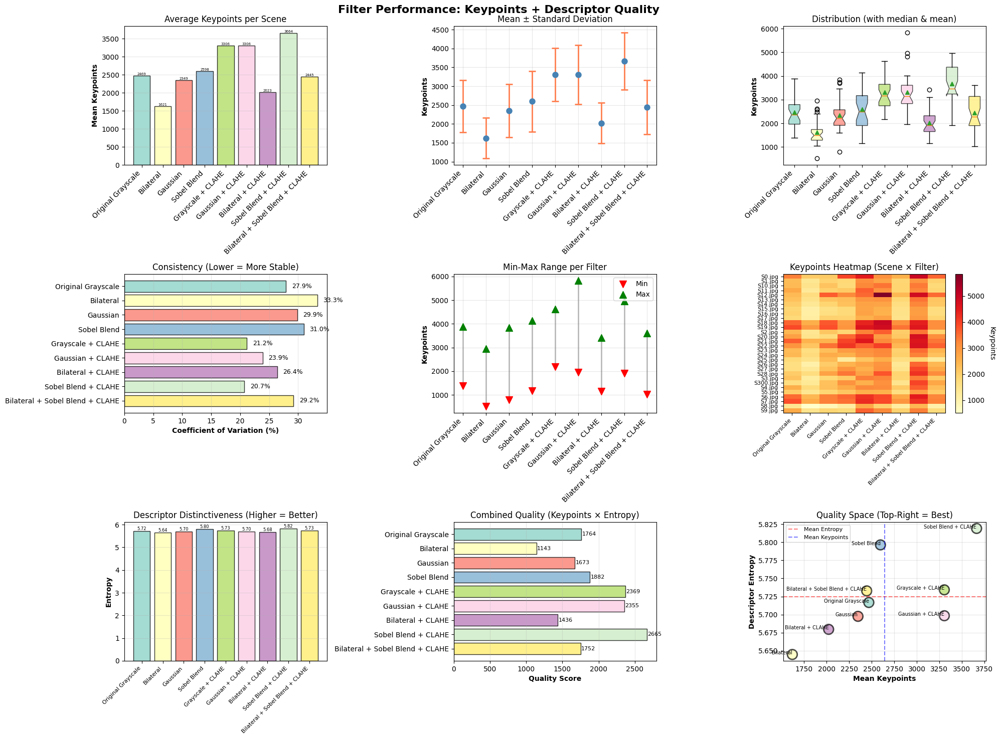

In [198]:
plot_filter_comparison(df_summary, results)

In [199]:
def print_recommendations(df_summary):
    """
    Stampa raccomandazioni basate sui risultati (con descrittori)
    """
    print("\n" + "="*80)
    print("💡 RECOMMENDATIONS (with descriptor analysis)")
    print("="*80 + "\n")
    
    # Miglior filtro per numero di keypoints
    best_mean = df_summary.loc[df_summary['Mean Keypoints'].idxmax()]
    print(f"🏆 MOST KEYPOINTS (on average):")
    print(f"   {best_mean['Filter']}: {best_mean['Mean Keypoints']:.0f} keypoints")
    print(f"   → Use when: You need maximum feature density\n")
    
    # Filtro più consistente
    best_consistency = df_summary.loc[df_summary['Coefficient of Variation (%)'].idxmin()]
    print(f"🎯 MOST CONSISTENT (across scenes):")
    print(f"   {best_consistency['Filter']}: CV = {best_consistency['Coefficient of Variation (%)']:.1f}%")
    print(f"   → Use when: You need predictable behavior\n")
    
    # 🆕 Miglior qualità descrittori
    best_entropy = df_summary.loc[df_summary['Descriptor Entropy'].idxmax()]
    print(f"🔬 MOST DISTINCTIVE DESCRIPTORS:")
    print(f"   {best_entropy['Filter']}: entropy = {best_entropy['Descriptor Entropy']:.2f}")
    print(f"   → Use when: Scenes with similar-looking books\n")
    
    # 🆕 Miglior bilanciamento GLOBALE
    best_quality = df_summary.loc[df_summary['Quality Score'].idxmax()]
    print(f"⚖️  BEST OVERALL QUALITY:")
    print(f"   {best_quality['Filter']}")
    print(f"   Quality Score: {best_quality['Quality Score']:.0f}")
    print(f"   Keypoints: {best_quality['Mean Keypoints']:.0f} | "
          f"Entropy: {best_quality['Descriptor Entropy']:.2f}")
    print(f"   → Use when: General purpose book detection\n")
    
    # Miglior bilanciamento (vecchio metodo)
    df_summary['Old Score'] = (
        df_summary['Mean Keypoints'] / df_summary['Mean Keypoints'].max() * 0.6 +
        (1 - df_summary['Coefficient of Variation (%)'] / df_summary['Coefficient of Variation (%)'].max()) * 0.4
    )
    best_balanced = df_summary.loc[df_summary['Old Score'].idxmax()]
    print(f"📊 BEST BALANCED (old metric):")
    print(f"   {best_balanced['Filter']}")
    print(f"   Mean: {best_balanced['Mean Keypoints']:.0f} kp, "
          f"CV: {best_balanced['Coefficient of Variation (%)']:.1f}%\n")

In [200]:
print_recommendations(df_summary)


💡 RECOMMENDATIONS (with descriptor analysis)

🏆 MOST KEYPOINTS (on average):
   Sobel Blend + CLAHE: 3664 keypoints
   → Use when: You need maximum feature density

🎯 MOST CONSISTENT (across scenes):
   Sobel Blend + CLAHE: CV = 20.7%
   → Use when: You need predictable behavior

🔬 MOST DISTINCTIVE DESCRIPTORS:
   Sobel Blend + CLAHE: entropy = 5.82
   → Use when: Scenes with similar-looking books

⚖️  BEST OVERALL QUALITY:
   Sobel Blend + CLAHE
   Quality Score: 2665
   Keypoints: 3664 | Entropy: 5.82
   → Use when: General purpose book detection

📊 BEST BALANCED (old metric):
   Sobel Blend + CLAHE
   Mean: 3664 kp, CV: 20.7%



In [201]:
def resize_image(img, max_dim=800):
    h, w = img.shape[:2]
    if max(h, w) > max_dim:
        scale = max_dim / max(h, w)
        img_resized = cv2.resize(img, (int(w*scale), int(h*scale)), interpolation=cv2.INTER_AREA)
        return img_resized
    return img

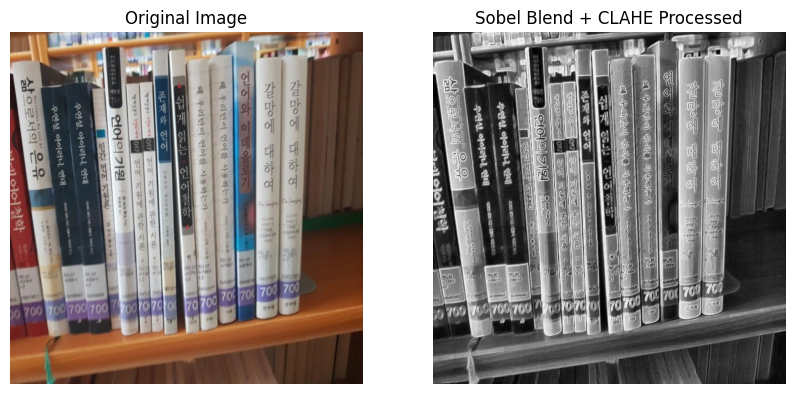

In [202]:
def sobel_clahe_pipeline(img):
    """
    Applica Sobel Blend seguito da CLAHE su un'immagine BGR.
    Restituisce l'immagine in scala di grigi risultante.
    """
    # Ridimensiona
    img = resize_image(img)

    # Sobel Blend
    sobel_blend_img = get_filter("sobel_blend", ksize=3)(img)
    
    # Converti in scala di grigi
    gray_sobel = convert_to_grayscale(sobel_blend_img)
    
    # CLAHE
    clahe_img = clahe_equalization(gray_sobel)
    
    return clahe_img

# Esempio di utilizzo della pipeline su una nuova immagine
new_image_path = "./dataset/scenes/scene_1.jpg"  # Cambia con
new_image = cv2.imread(new_image_path)
if new_image is not None:
    processed_image = sobel_clahe_pipeline(new_image)
    
    plt.figure(figsize=(10,5))
    plt.subplot(1,2,1)
    plt.imshow(cv2.cvtColor(new_image, cv2.COLOR_BGR2RGB))
    plt.title("Original Image")
    plt.axis("off")
    
    plt.subplot(1,2,2)
    plt.imshow(processed_image, cmap='gray')
    plt.title("Sobel Blend + CLAHE Processed")
    plt.axis("off")
    
    plt.show()

## Implementation of the Book Recognition Pipeline

### Configuration Parameters

In [203]:
from dataclasses import dataclass

@dataclass
class RecognitionConfig:
    # --- SCELTA ALGORITMO ---
    feature_type: str = 'SIFT'      # Opzioni: 'SIFT' oppure 'AKAZE'
    
    # --- FEATURES SIFT ---
    nfeatures: int = 10000               # Numero massimo di features da rilevare
    contrast_threshold: float = 0.05    # Soglia di contrasto (più bassa = più punti)
    edge_threshold: float = 25          # Soglia di edge (più alta = più punti)
    use_root_sift: bool = True      

    # --- FEATURES AKAZE (Nuovi) ---
    akaze_thresh: float = 0.0001        # Soglia rilevamento Akaze (più bassa = più punti)

    # --- MATCHING ---
    lowe_ratio: float = 0.90            # Rapporto di Lowe per il filtro dei matches (0.7-0.9 tipico)
    
    # --- RANSAC & GEOMETRIA ---
    ransac_method: int = cv2.RANSAC     # cv2.USAC_MAGSAC
    ransac_thresh: float = 8.0          # Soglia RANSAC in pixel (più bassa = più rigida)
    min_matches_to_verify: int = 4     # Min matches per tentare RANSAC
    min_inliers: int = 5                # Min inliers per considerare valida una stima (più alta = più rigida)         
    
    # --- VALIDAZIONE ---
    min_area: int = 1000                # Area minima del bounding box stimato per accettare la rilevazione          
    min_det: float = 0.01               # Min detection score (evita detection troppo piccole o improbabili)       
    max_cos_diff: float = 0.35          # Tolleranza rettangolarità (0=perfetto, 1=qualsiasi angolo)
    max_iterations: int = 30

### Preprocessing with filtering and resizing

In [204]:
import cv2
import numpy as np
from typing import Tuple

class ImagePreprocessor:
    """
    Gestisce il preprocessing delle immagini in modo modulare e autoconsistente.
    Include ridimensionamento, filtraggio e conversione colori.
    """
    def __init__(self, config: RecognitionConfig):
        self.config = config

    def load_image(self, image_path: str) -> np.ndarray:
        """Carica immagine da file controllando errori."""
        img = cv2.imread(image_path)
        if img is None:
            raise ValueError(f"Failed to load image: {image_path}")
        return img

    def _convert_to_grayscale(self, img: np.ndarray) -> np.ndarray:
        if len(img.shape) == 3:
            return cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        return img

    def _clahe_equalization(self, img_gray):
        # ALZIAMO IL CLIP LIMIT!
        # 2.0 è standard. Per libri al buio usa 3.0 o 4.0.
        # tileGridSize=(8,8) va bene.
        clahe = cv2.createCLAHE(clipLimit=4.0, tileGridSize=(8, 8))
        return clahe.apply(img_gray)

    def apply_filter(self, img_bgr: np.ndarray) -> np.ndarray:
        """
        Versione PULITA per SIFT.
        Niente Sobel: confonde solo i descrittori SIFT.
        """
        if img_bgr is None: return None
        
        # 1. Grayscale puro
        gray = self._convert_to_grayscale(img_bgr)
        
        # 2. CLAHE (Fondamentale per il contrasto locale)
        gray = self._clahe_equalization(gray)
        
        # 3. (Opzionale ma raccomandato) Unsharp Masking Leggero
        # Questo, a differenza del Sobel, "stacca" il testo senza deformarlo.
        # Kernel gaussiano per sfocare, poi sottraiamo all'originale.
        gaussian = cv2.GaussianBlur(gray, (0, 0), 2.0)
        gray = cv2.addWeighted(gray, 1.5, gaussian, -0.5, 0)
        
        return gray

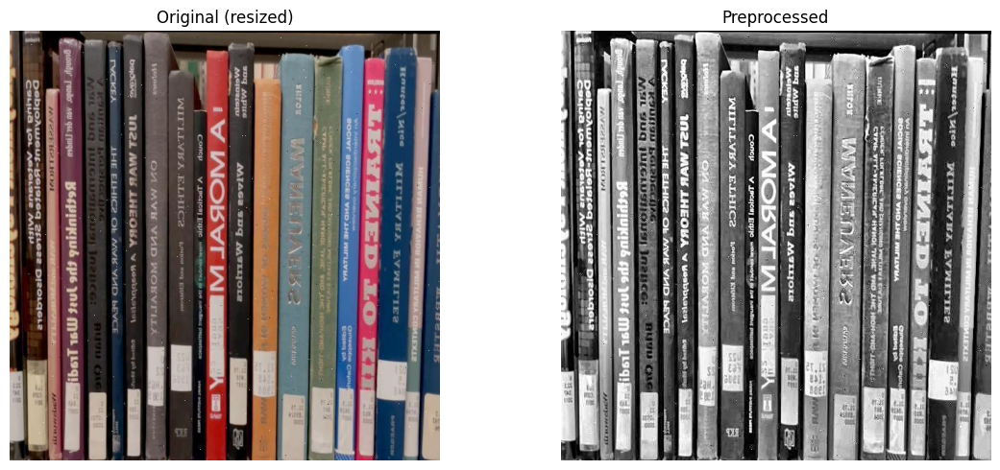

✅ Preprocessing test OK
   Original shape: (640, 640, 3)
   Processed shape: (640, 640)


In [205]:
# Utility per test rapido
def test_preprocessor():
    """Test del preprocessor su un'immagine di esempio"""
    config  = RecognitionConfig()
    preprocessor = ImagePreprocessor(config)

    img_orig = preprocessor.load_image("./dataset/scenes/scene_0.jpg")
    gray_proc = preprocessor.apply_filter(img_orig)
    
    fig, axes = plt.subplots(1, 2, figsize=(12, 5))
    axes[0].imshow(cv2.cvtColor(img_orig, cv2.COLOR_BGR2RGB))
    axes[0].set_title("Original (resized)")
    axes[0].axis('off')
    
    axes[1].imshow(gray_proc, cmap='gray')
    axes[1].set_title(f"Preprocessed")
    axes[1].axis('off')
    
    plt.tight_layout()
    plt.show()
    
    print(f"✅ Preprocessing test OK")
    print(f"   Original shape: {img_orig.shape}")
    print(f"   Processed shape: {gray_proc.shape}")

# Testa
# test_preprocessor()
test_preprocessor()

### Feature Extraction with SIFT

In [206]:
from typing import List


class Extractor:
    def __init__(self, config: RecognitionConfig):
        self.cfg = config
        
        if self.cfg.feature_type == 'SIFT':
            self.detector = cv2.SIFT_create(
                nfeatures=self.cfg.nfeatures,
                contrastThreshold=self.cfg.contrast_threshold,
                edgeThreshold=self.cfg.edge_threshold,
                nOctaveLayers=4
            )
        elif self.cfg.feature_type == 'AKAZE':
            self.detector = cv2.AKAZE_create(
                threshold=self.cfg.akaze_thresh
            )
        else:
            raise ValueError(f"Feature type {self.cfg.feature_type} non supportato.")

    def extract(self, img):
        if img is None: return [], None
        
        # Detect & Compute
        kp, des = self.detector.detectAndCompute(img, None)
        
        if des is None: return kp, None

        # Post-processing specifico per SIFT (RootSIFT)
        if self.cfg.feature_type == 'SIFT':
            des = des.astype(np.float32)
            if self.cfg.use_root_sift:
                eps = 1e-7
                des /= (des.sum(axis=1, keepdims=True) + eps)
                des = np.sqrt(des)
        
        # AKAZE esce già come binario (uint8), non va toccato!
        return kp, des
    
    def visualize_keypoints(self, img: np.ndarray, keypoints: List[cv2.KeyPoint], title: str = "SIFT Keypoints"):
        """Visualizza keypoints sull'immagine."""
        if img is None:
            print("[WARN] Immagine vuota, impossibile visualizzare keypoints.")
            return

        # Assicuriamoci che l'immagine sia uint8 per drawKeypoints
        img_vis = img.copy()
        if img_vis.dtype != np.uint8:
            img_vis = cv2.normalize(img_vis, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)

        img_kp = cv2.drawKeypoints(
            img_vis, 
            keypoints, 
            None,
            flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS
        )
        
        plt.figure(figsize=(12, 8))
        if len(img_kp.shape) == 3:
            plt.imshow(cv2.cvtColor(img_kp, cv2.COLOR_BGR2RGB))
        else:
            plt.imshow(img_kp, cmap='gray')
            
        plt.title(f"{title} ({len(keypoints)} keypoints)")
        plt.axis('off')
        plt.tight_layout()
        plt.show()

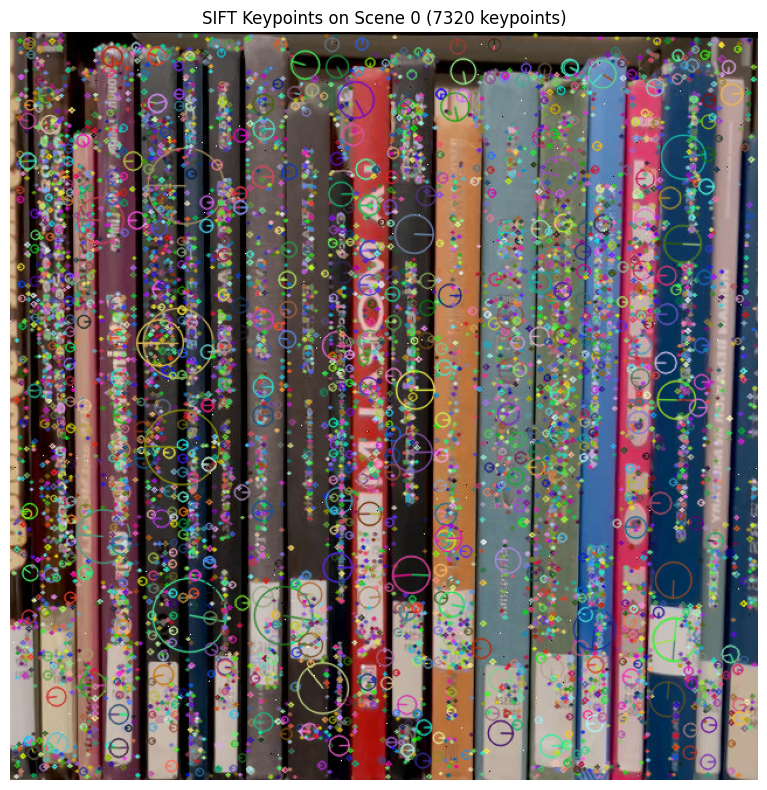

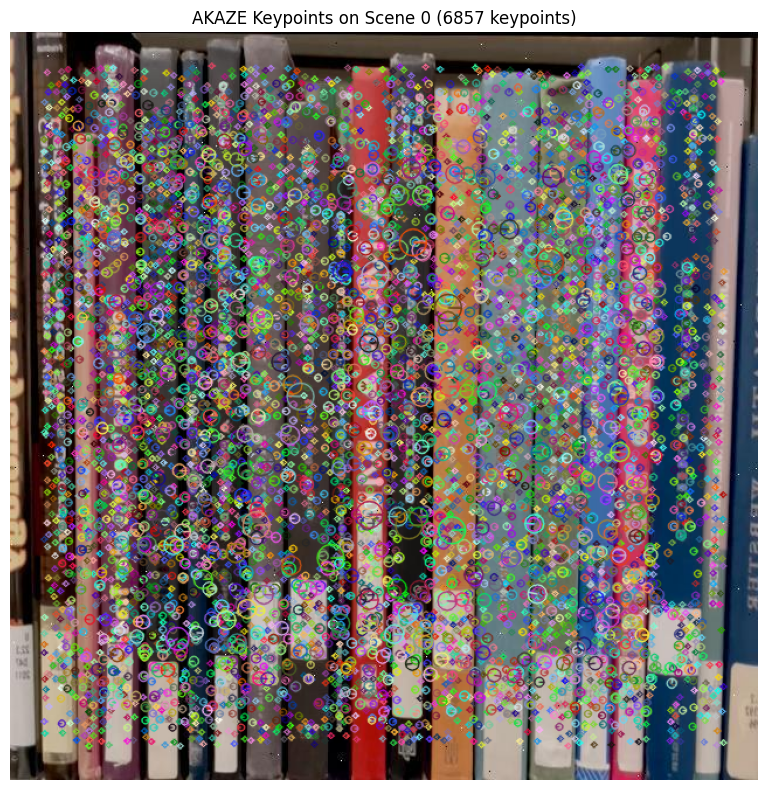

In [207]:
config = RecognitionConfig()

preprocessor = ImagePreprocessor(config=config)
img = preprocessor.load_image("./dataset/scenes/scene_0.jpg")
gray_img = preprocessor.apply_filter(img)

config.feature_type = 'SIFT'
extractor = Extractor(config=config)
keypoints, descriptors = extractor.extract(gray_img)
extractor.visualize_keypoints(img, keypoints, title="SIFT Keypoints on Scene 0")

# Teste AKAZE
config.feature_type = 'AKAZE'
extractor_akaze = Extractor(config=config)
keypoints_akaze, descriptors_akaze = extractor_akaze.extract(gray_img)
extractor_akaze.visualize_keypoints(img, keypoints_akaze, title="AKAZE Keypoints on Scene 0")


### Matching with FLANN and Lowe's ratio test

In [208]:
class Matcher:
    def __init__(self, config: RecognitionConfig):
        self.cfg = config
        
        # Selezione Norma
        if self.cfg.feature_type == 'SIFT':
            norm_type = cv2.NORM_L2
        else: # AKAZE, ORB
            norm_type = cv2.NORM_HAMMING
            
        self.bf = cv2.BFMatcher(norm_type, crossCheck=False)

    def match(self, des_model, des_scene, kp_model=None, kp_scene=None, shape_model=None, shape_scene=None, use_gms=False):
        """
        Esegue il matching.
        NOTA: kp_scene e des_scene devono essere GIA' il subset dei punti attivi.
        """
        if des_model is None or des_scene is None or len(des_scene) < 2:
            return []

        # --- GMS STRATEGY ---
        if use_gms:
            if kp_model is None or kp_scene is None or shape_model is None or shape_scene is None:
                print("[WARN] GMS attivo ma mancano dati. Fallback su Lowe.")
            else:
                try:
                    matches_all = self.bf.match(des_model, des_scene)
                    h_m, w_m = shape_model[:2]
                    h_s, w_s = shape_scene[:2]
                    
                    matches_gms = cv2.xfeatures2d.matchGMS(
                        (w_m, h_m), (w_s, h_s), 
                        kp_model, kp_scene, 
                        matches_all,
                        withRotation=True, 
                        withScale=True,
                        thresholdFactor=3.0 # Un po' più permissivo (default 6.0)
                    )
                    return matches_gms
                except Exception as e:
                    # Spesso GMS fallisce se ci sono troppi pochi punti
                    pass 

        # --- LOWE'S RATIO STRATEGY (Fallback o Default) ---
        try:
            matches = self.bf.knnMatch(des_model, des_scene, k=2)
        except cv2.error:
            return []
            
        good = []
        # Ratio adattivo: SIFT vuole 0.8, AKAZE vuole 0.9+
        ratio = self.cfg.lowe_ratio
        if self.cfg.feature_type != 'SIFT' and ratio < 0.9:
            ratio = 0.92

        for m_group in matches:
            if len(m_group) == 2:
                m, n = m_group
                if m.distance < ratio * n.distance:
                    good.append(m)
        return good

    def compute_geometry(self, matches, kp_model, kp_scene_subset, model_shape):
        """
        Calcola H e BBox.
        Accetta kp_scene_subset: la lista di punti corrispondente ESATTAMENTE ai match.
        Nessuna mappatura di indici qui dentro!
        """
        if len(matches) < self.cfg.min_matches_to_verify:
            return None, None, 0, None

        # Estrazione coordinate
        # m.trainIdx si riferisce all'indice in kp_scene_subset
        src_pts = np.float32([kp_model[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2)
        dst_pts = np.float32([kp_scene_subset[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2)
        
        try:
            M, mask = cv2.findHomography(src_pts, dst_pts, self.cfg.ransac_method, self.cfg.ransac_thresh)
        except cv2.error:
            return None, None, 0, None
            
        if M is None: return None, None, 0, None
            
        inliers_count = int(mask.ravel().sum())
        if inliers_count < self.cfg.min_inliers:
            return None, None, inliers_count, None

        # Proiezione Box
        h, w = model_shape[:2]
        corners = np.float32([[0, 0], [w, 0], [w, h], [0, h]]).reshape(-1, 1, 2)
        bbox = cv2.perspectiveTransform(corners, M)
        
        return M, mask, inliers_count, bbox

Keypoints Scena: 6088 | Keypoints Modello: 131
Esito Geometria -> Inliers: 5


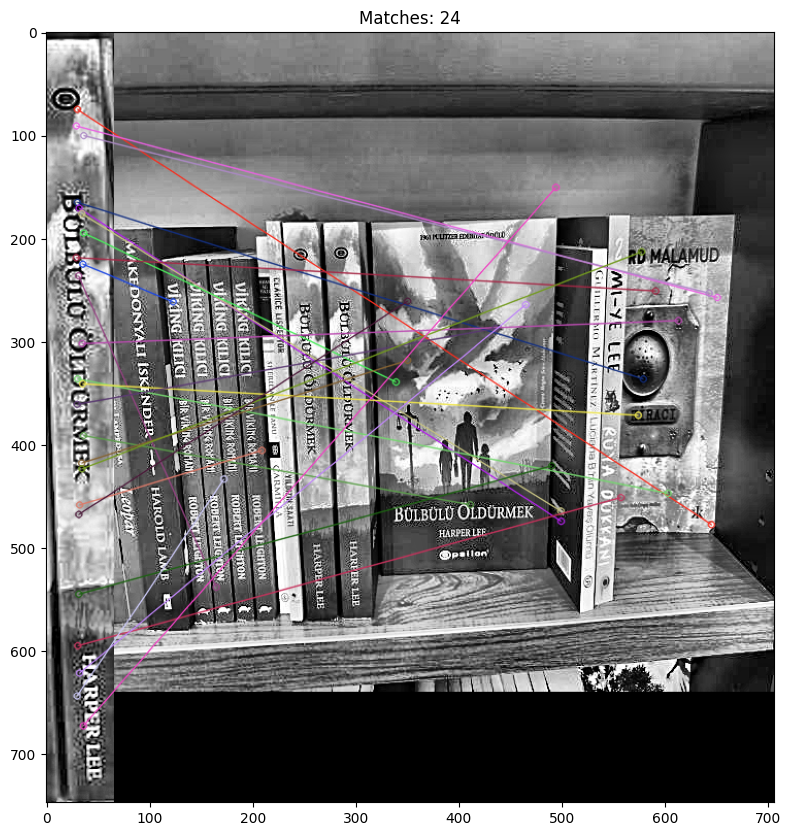

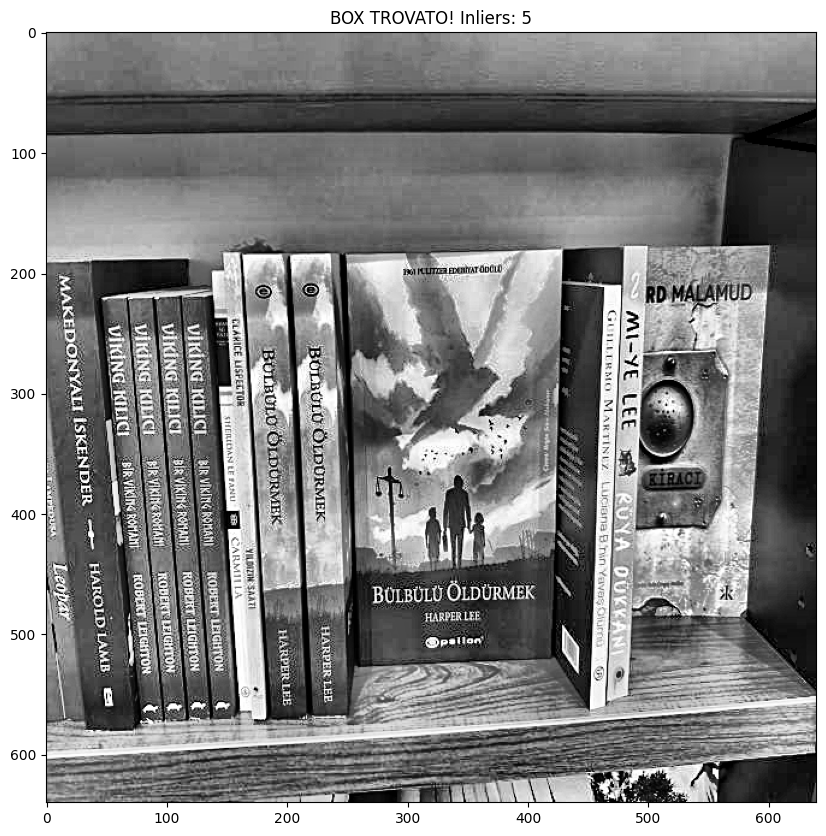

Keypoints Scena: 6088 | Keypoints Modello: 3051
Esito Geometria -> Inliers: 310


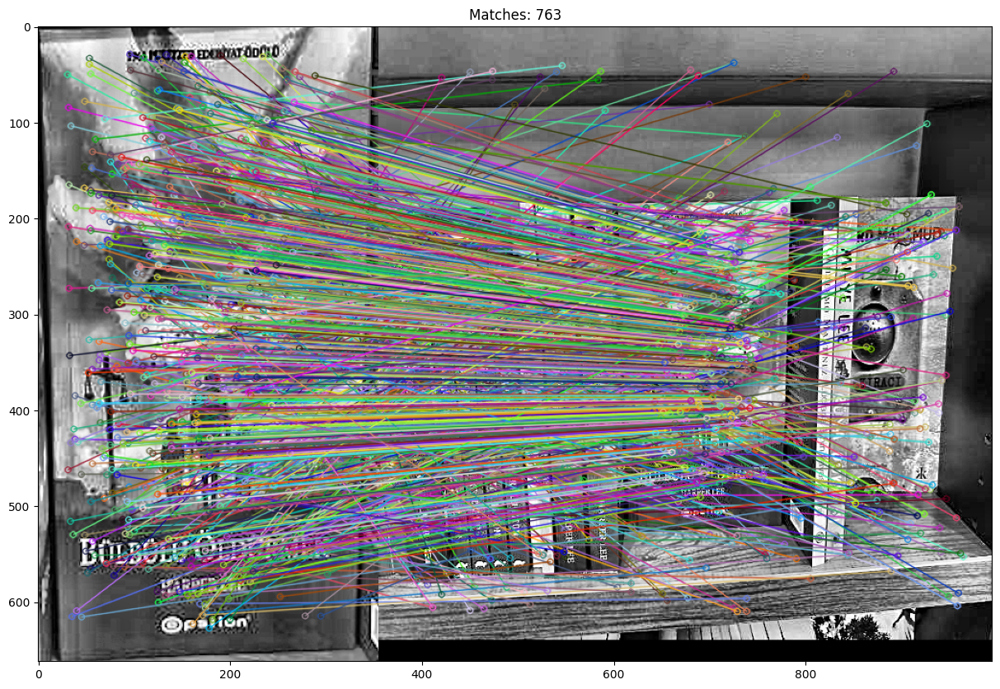

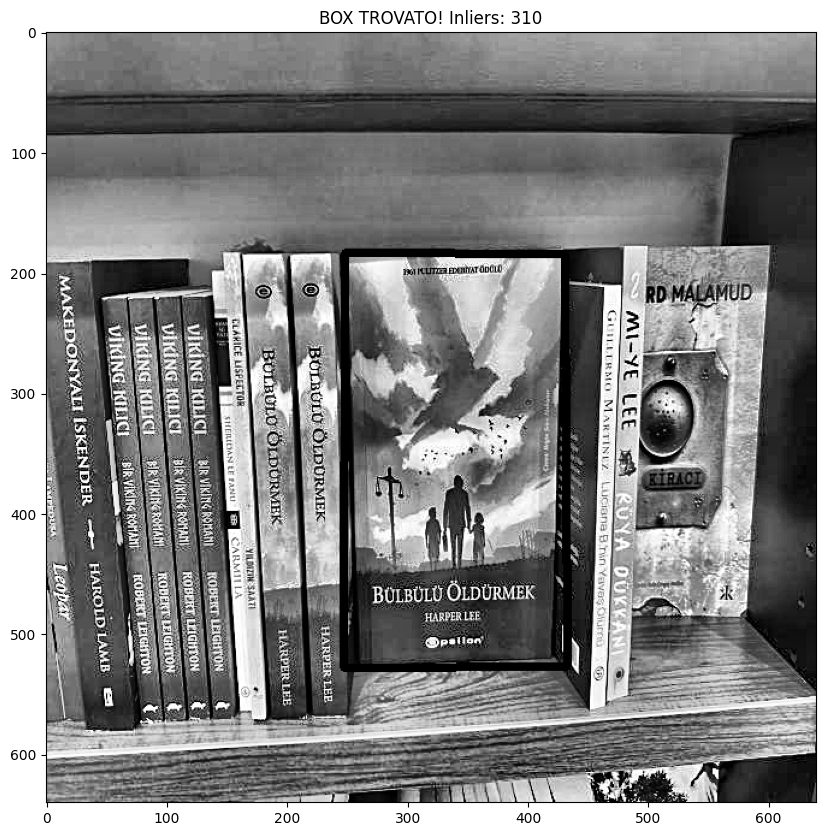

Keypoints Scena: 4990 | Keypoints Modello: 1092
Esito Geometria -> Inliers: 52


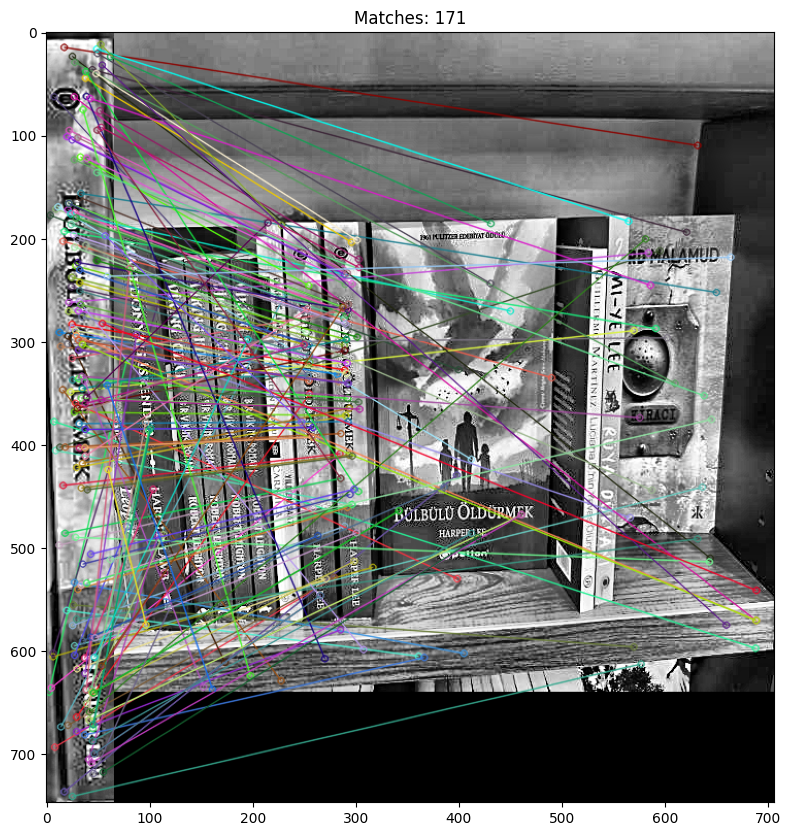

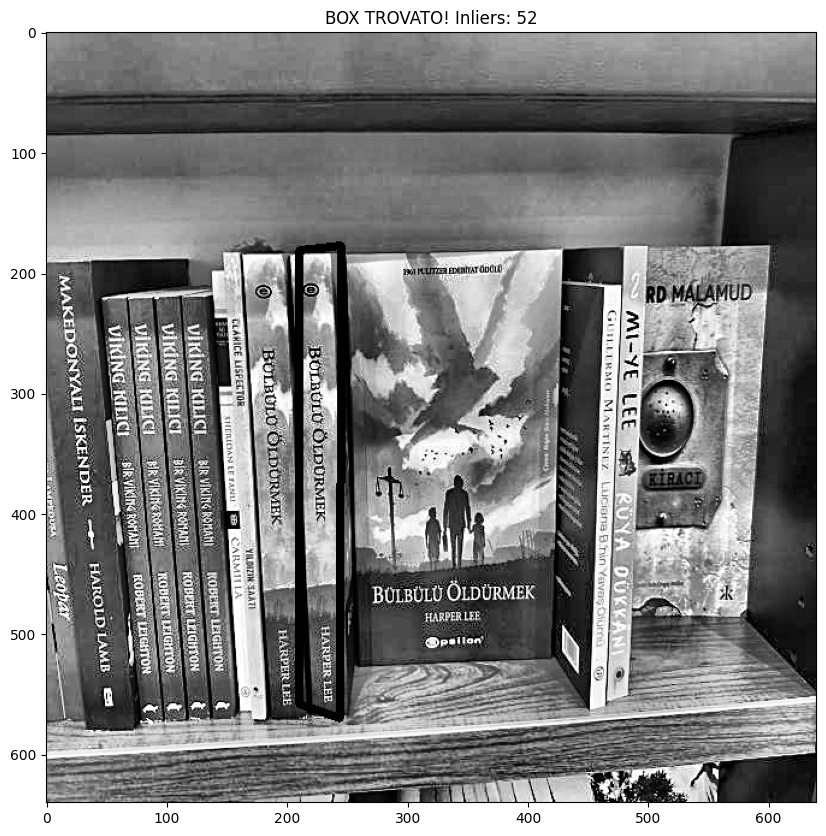

Keypoints Scena: 4990 | Keypoints Modello: 3507
Esito Geometria -> Inliers: 425


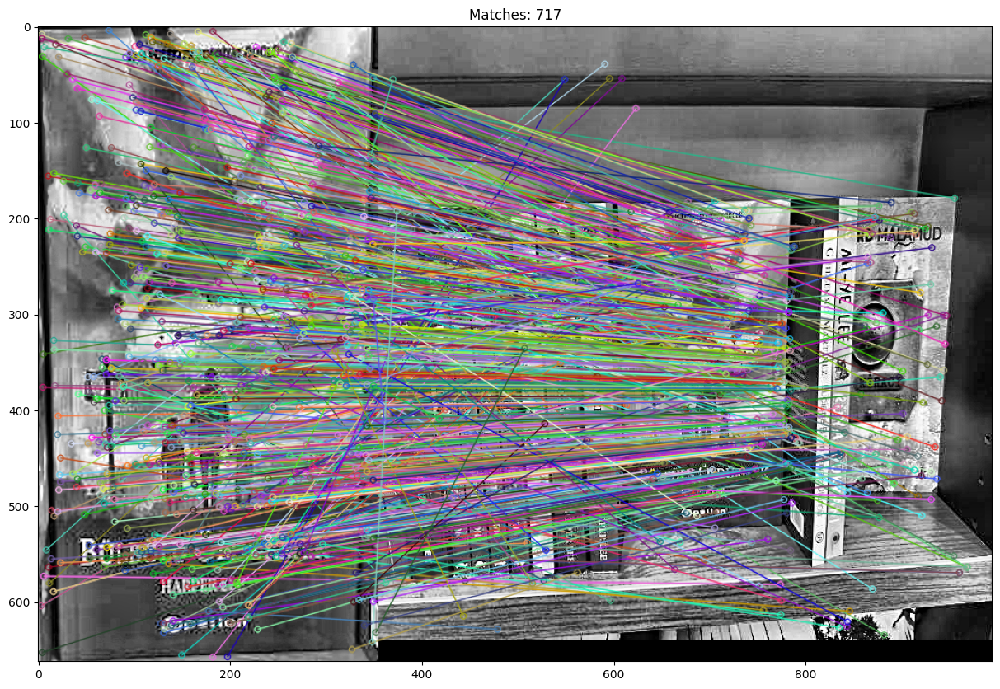

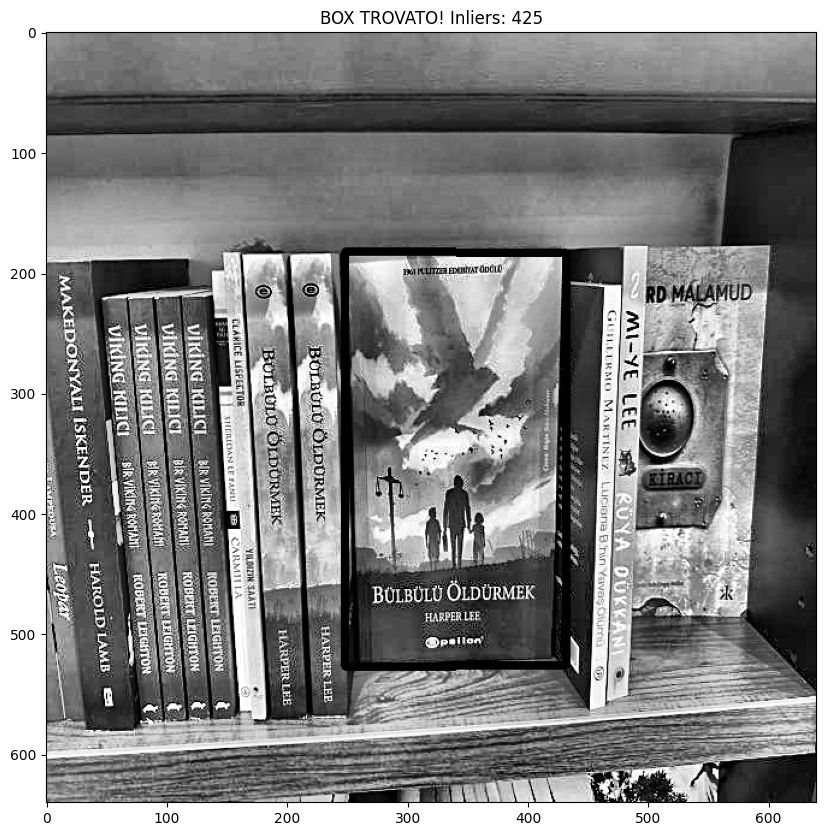

In [209]:
def test_matcher(scene_id, model_id, config=None):
    
    # CARICA IMMAGINI E PREPROCESSING
    preprocessor = ImagePreprocessor(config)
    path_scene = f"./dataset/scenes/scene_{scene_id}.jpg"
    path_model = f"./dataset/models/model_{model_id}.png"
    img_scene = preprocessor.load_image(path_scene)
    img_model = preprocessor.load_image(path_model)
    img_scene = preprocessor.apply_filter(img_scene)
    img_model = preprocessor.apply_filter(img_model)
    if img_scene is None or img_model is None:
        print("Errore caricamento immagini.")
        return

    # ESTRAZIONE FEATURES
    extractor = Extractor(config) # Usa la tua classe
    kp_s, des_s = extractor.extract(img_scene)
    kp_m, des_m = extractor.extract(img_model)
    
    print(f"Keypoints Scena: {len(kp_s)} | Keypoints Modello: {len(kp_m)}")

    # --- 4. TEST MATCHER.MATCH ---
    matcher = Matcher(config)
    
    # Chiamata al Metodo 1
    good_matches = matcher.match(des_m, des_s, 
                                 kp_model=kp_m, kp_scene=kp_s, 
                                 shape_model=img_model.shape, 
                                 shape_scene=img_scene.shape,
                                 use_gms=False)  # Cambia a True per GMS
    
    if len(good_matches) == 0:
        print("STOP: Nessun match trovato. Alza il lowe_ratio!")
        return

    # --- 5. TEST MATCHER.COMPUTE_GEOMETRY ---
    # Chiamata al Metodo 2
    M, mask, inliers, bbox = matcher.compute_geometry(good_matches, kp_m, kp_s, img_model.shape)
    
    print(f"Esito Geometria -> Inliers: {inliers}")
    
    # --- 6. VISUALIZZAZIONE ---
    out_img = img_scene.copy()
    
    # Disegna i match (linee verdi)
    match_img = cv2.drawMatches(img_model, kp_m, img_scene, kp_s, good_matches, None, 
                                flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    
    plt.figure(figsize=(15,10))
    plt.imshow(cv2.cvtColor(match_img, cv2.COLOR_BGR2RGB))
    plt.title(f"Matches: {len(good_matches)}")
    plt.show()

    # Disegna il box se trovato
    if bbox is not None:
        cv2.polylines(out_img, [np.int32(bbox)], True, (0, 255, 0), 5)
        plt.figure(figsize=(10,10))
        plt.imshow(cv2.cvtColor(out_img, cv2.COLOR_BGR2RGB))
        plt.title(f"BOX TROVATO! Inliers: {inliers}")
        plt.show()
    else:
        print("Nessun Box valido calcolato.")

config = RecognitionConfig(feature_type='AKAZE')
# --- ESECUZIONE ---
# Assicurati di aver definito RecognitionConfig e UniversalExtractor prima
test_matcher(26, 0, config)
test_matcher(26, 4, config)

config = RecognitionConfig(feature_type='SIFT')

# --- ESECUZIONE ---
test_matcher(26, 0, config)
test_matcher(26, 4, config)

### Geometry Validation

In [210]:
class GeometryValidator:
    def __init__(self, config: RecognitionConfig):
        self.cfg = config

    def validate(self, H, bbox, scene_shape):
        """
        Valida geometria usando H (per orientamento) e bbox (per forma).
        """
        if H is None or bbox is None: 
            return False, "Null input"

        # 1. Check Determinante (Evita riflessioni e schiacciamenti estremi)
        # Fondamentale: impedisce che il libro venga rilevato "al contrario" o su una linea
        det = np.linalg.det(H[0:2, 0:2])
        if det < 0: return False, "Reflected (Neg Det)"
        if abs(det) < self.cfg.min_det: return False, "Degenerate (Too thin)"

        # 2. Check Convessità
        if not cv2.isContourConvex(np.int32(bbox)):
            return False, "Not convex"
            
        # 3. Check Area
        area = cv2.contourArea(bbox)
        scene_area = scene_shape[0] * scene_shape[1]
        
        if area < self.cfg.min_area: return False, f"Too small ({area:.0f})"
        if area > scene_area * 0.9: return False, "Too big"

        # 4. Check Rettangolarità (Angoli ~90 gradi)
        # Questo controllo c'era nell'originale ed è cruciale per evitare forme strane
        pts = bbox.reshape(4, 2).astype(np.float32)
        
        def angle_cos(p0, p1, p2):
            d1, d2 = (p0-p1), (p2-p1)
            norm = np.linalg.norm(d1) * np.linalg.norm(d2)
            return abs(np.dot(d1, d2) / (norm + 1e-7))

        cosines = []
        for i in range(4):
            # Angolo al vertice i formato dai vicini
            p0, p1, p2 = pts[i-1], pts[i], pts[(i+1)%4]
            cosines.append(angle_cos(p0, p1, p2))
        
        max_cos = max(cosines)
        if max_cos > self.cfg.max_cos_diff: 
            return False, f"Not rectangular (cos={max_cos:.2f})"

        return True, "Valid"

### Pipeline Integration for Book Recognition

In [211]:
class IterativeBookRecognizer:
    def __init__(self, config: RecognitionConfig):
        self.cfg = config
        self.preprocessor = ImagePreprocessor(config=config)
        self.extractor = Extractor(config=config) # Assumo si chiami così la tua classe universale
        self.matcher = Matcher(config=config)
        self.validator = GeometryValidator(config=config)
        self.templates = {} 

    def add_template(self, book_id: str, img_bgr: np.ndarray):
        gray = self.preprocessor.apply_filter(img_bgr)
        kp, des = self.extractor.extract(gray)
        if des is None or len(kp) < 10: return
        self.templates[book_id] = {"kp": kp, "des": des, "shape": gray.shape}

    def recognize(self, scene_img_bgr):
        # 1. Estrazione Scena
        gray_scene = self.preprocessor.apply_filter(scene_img_bgr)
        kp_scene, des_scene = self.extractor.extract(gray_scene)
        
        if des_scene is None or len(kp_scene) < self.cfg.min_inliers: return []

        available_mask = np.ones(len(kp_scene), dtype=bool)
        found_books = [] 

        for i in range(self.cfg.max_iterations):
            if np.sum(available_mask) < self.cfg.min_inliers: break

            # --- PREPARAZIONE DATI (Il segreto è qui) ---
            active_indices = np.where(available_mask)[0]
            
            # Creiamo i SUBSET fisici. 
            # Il matcher vedrà solo questi e risponderà con indici 0..N relativi a questi.
            current_des_scene = des_scene[active_indices]
            current_kp_scene = [kp_scene[i] for i in active_indices] 
            
            best_candidate = None

            for book_id, tpl in self.templates.items():
                
                # Chiamata Matcher (passiamo i SUBSET)
                matches = self.matcher.match(
                    des_model=tpl["des"], 
                    des_scene=current_des_scene, 
                    #kp_model=tpl["kp"], 
                    #kp_scene=current_kp_scene, # Subset!
                    #shape_model=tpl["shape"], 
                    #shape_scene=gray_scene.shape, # Shape serve originale per GMS
                    #use_gms=True # Metti True se vuoi testare GMS, ma inizia con False
                )

                # Chiamata Geometria (passiamo il SUBSET di keypoint)
                M, mask, inliers, bbox = self.matcher.compute_geometry(
                    matches, 
                    tpl["kp"], 
                    current_kp_scene, # Subset!
                    tpl["shape"]
                )
                
                if bbox is None: continue 

                # Validazione
                is_valid, msg = self.validator.validate(M, bbox, gray_scene.shape)
                
                if is_valid:
                    if best_candidate is None or inliers > best_candidate["score"]:
                        best_candidate = {
                            "book_id": book_id,
                            "score": inliers,
                            "bbox": bbox
                        }

            # --- RISULTATO E PEELING ---
            if best_candidate:
                found_books.append(best_candidate)
                print(f"Iter {i+1}: Trovato {best_candidate['book_id']} ({best_candidate['score']} inliers)")

                # SPATIAL PEELING
                x, y, w, h = cv2.boundingRect(np.int32(best_candidate["bbox"]))
                bbox_contour = best_candidate["bbox"].astype(np.float32)
                
                # Iteriamo sugli active_indices originali per aggiornare la maschera globale
                for idx_in_subset, global_idx in enumerate(active_indices):
                    pt = current_kp_scene[idx_in_subset].pt 
                    
                    if x <= pt[0] <= x+w and y <= pt[1] <= y+h:
                        if cv2.pointPolygonTest(bbox_contour, pt, False) >= 0:
                            available_mask[global_idx] = False
            else:
                break # Nessun altro libro trovato
                
        return found_books

### Main execution Loop

Loading models from ./dataset/models/...
✅ 22 Models loaded.
Found 30 scenes to process.

Processing: scene_0.jpg...


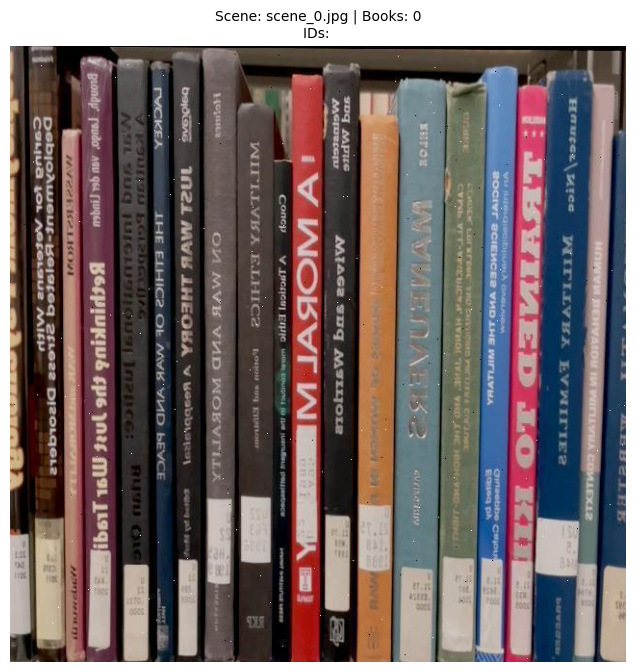


Processing: scene_1.jpg...
Iter 1: Trovato model_18 (90 inliers)
Iter 2: Trovato model_18 (85 inliers)


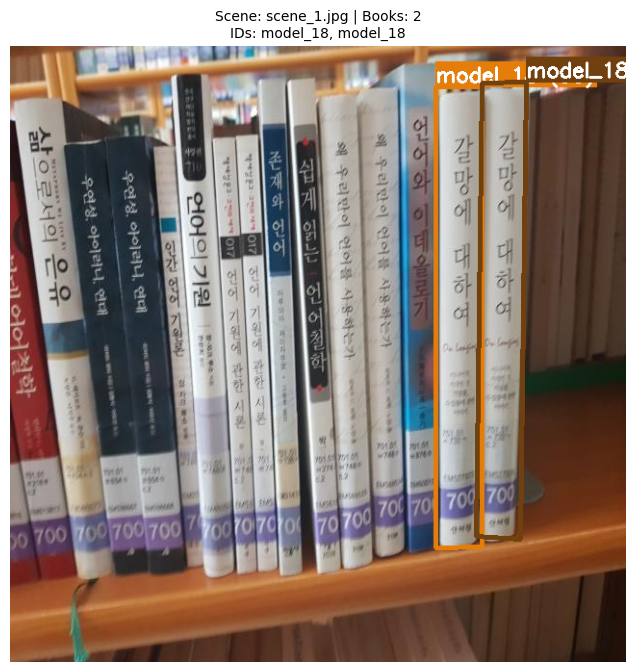


Processing: scene_10.jpg...
Iter 1: Trovato model_19 (18 inliers)


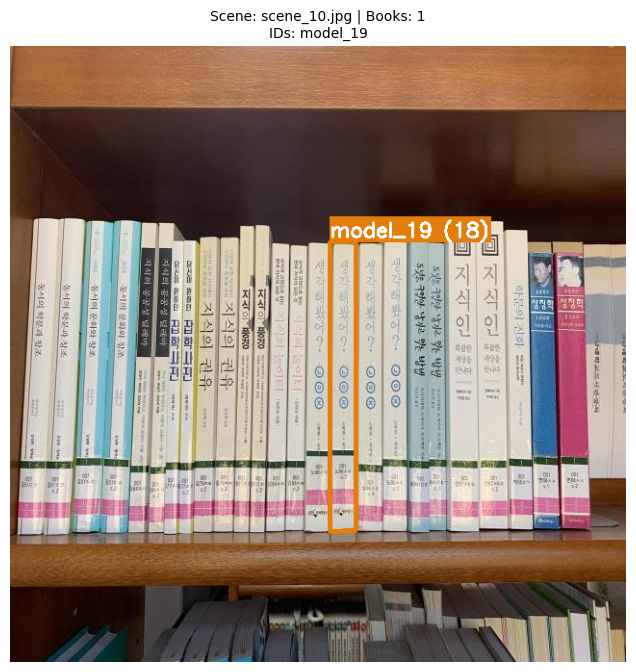


Processing: scene_11.jpg...


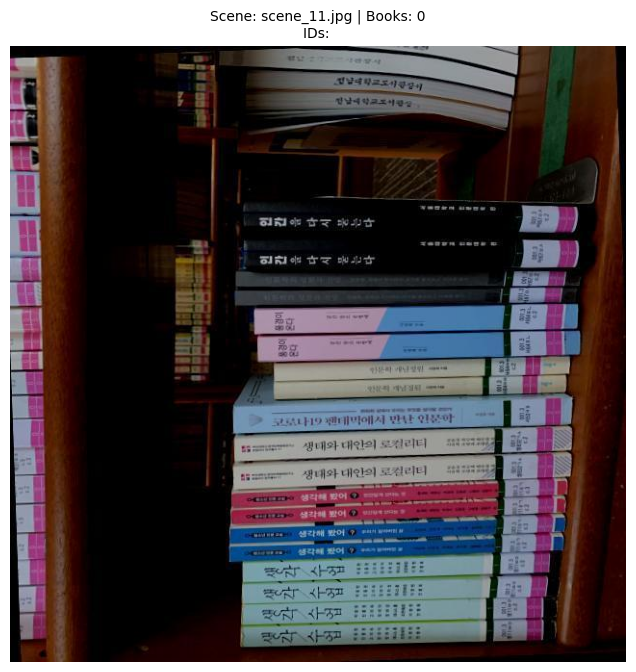


Processing: scene_12.jpg...


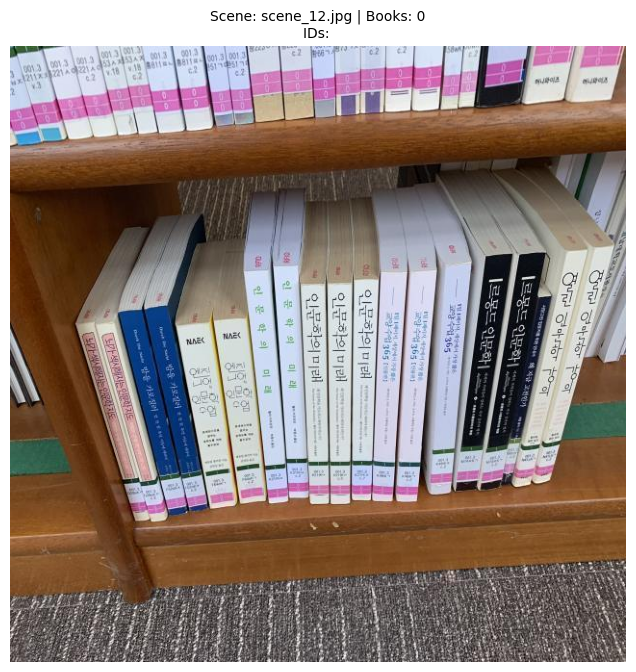


Processing: scene_13.jpg...


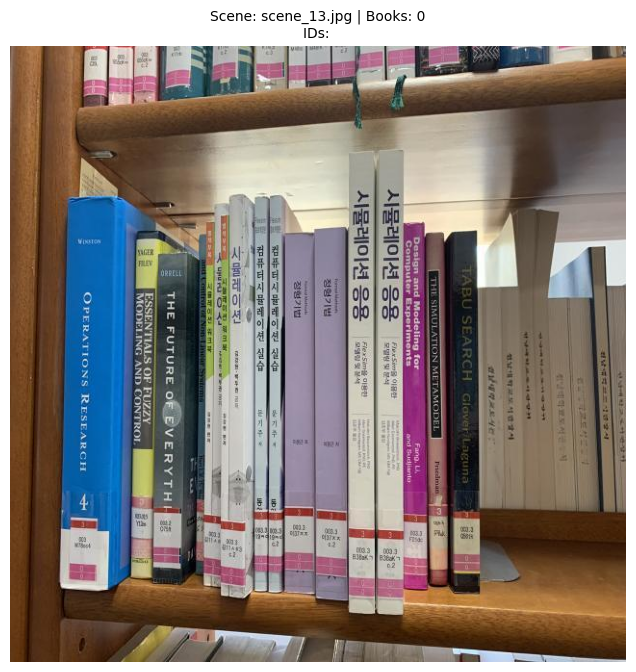


Processing: scene_14.jpg...


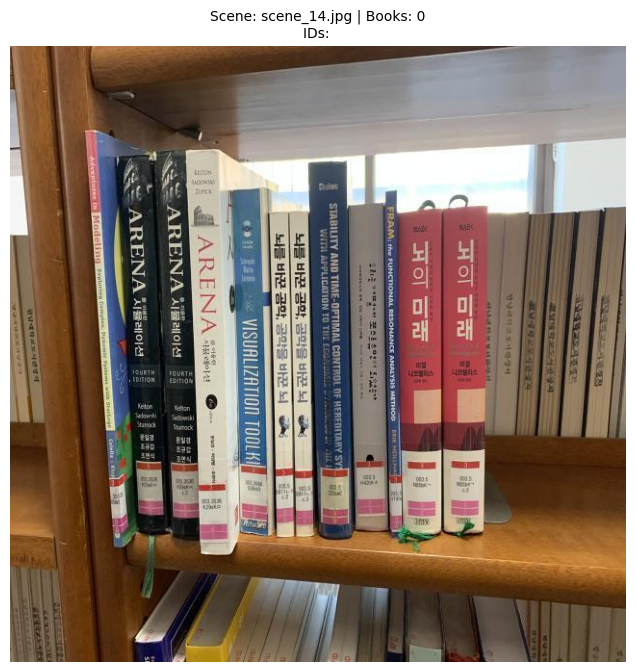


Processing: scene_15.jpg...
Iter 1: Trovato model_11 (68 inliers)
Iter 2: Trovato model_12 (30 inliers)
Iter 3: Trovato model_11 (20 inliers)


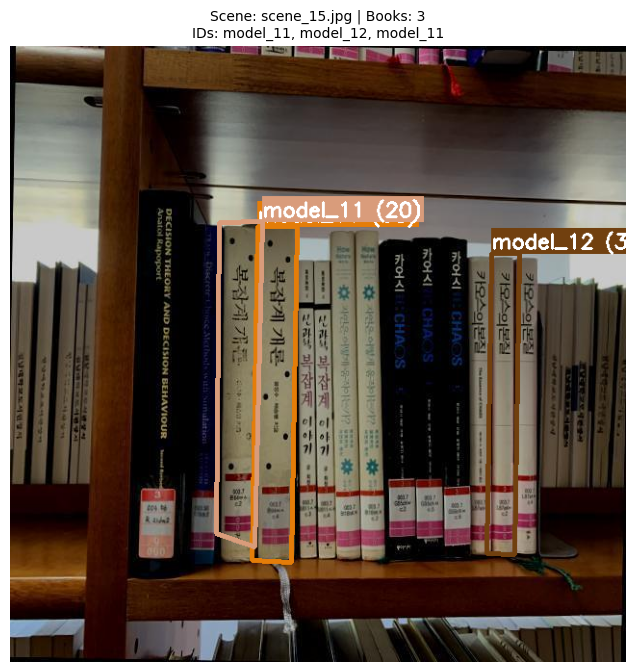


Processing: scene_16.jpg...
Iter 1: Trovato model_11 (68 inliers)
Iter 2: Trovato model_12 (32 inliers)
Iter 3: Trovato model_12 (26 inliers)
Iter 4: Trovato model_11 (21 inliers)


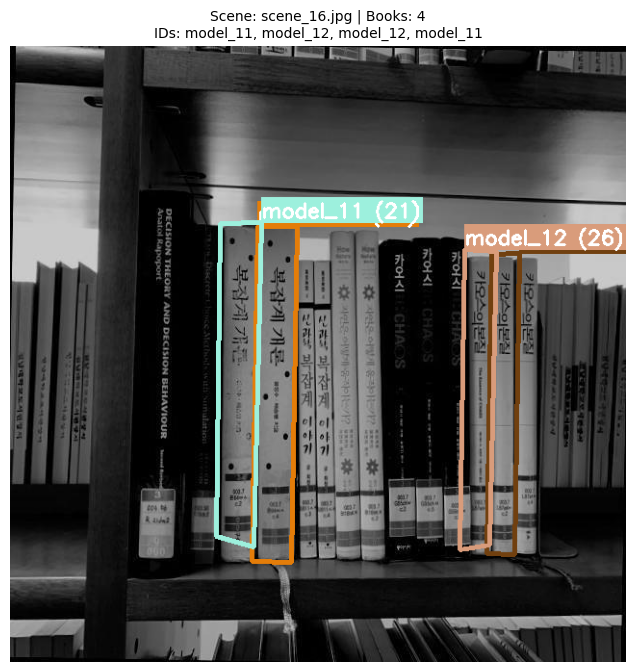


Processing: scene_17.jpg...
Iter 1: Trovato model_11 (66 inliers)
Iter 2: Trovato model_12 (47 inliers)


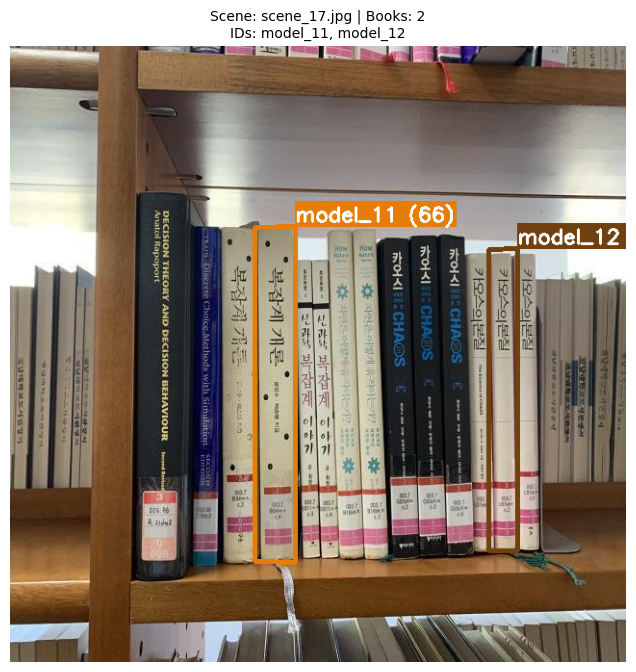


Processing: scene_18.jpg...
Iter 1: Trovato model_8 (61 inliers)
Iter 2: Trovato model_10 (45 inliers)
Iter 3: Trovato model_9 (41 inliers)
Iter 4: Trovato model_9 (27 inliers)
Iter 5: Trovato model_10 (27 inliers)
Iter 6: Trovato model_10 (41 inliers)


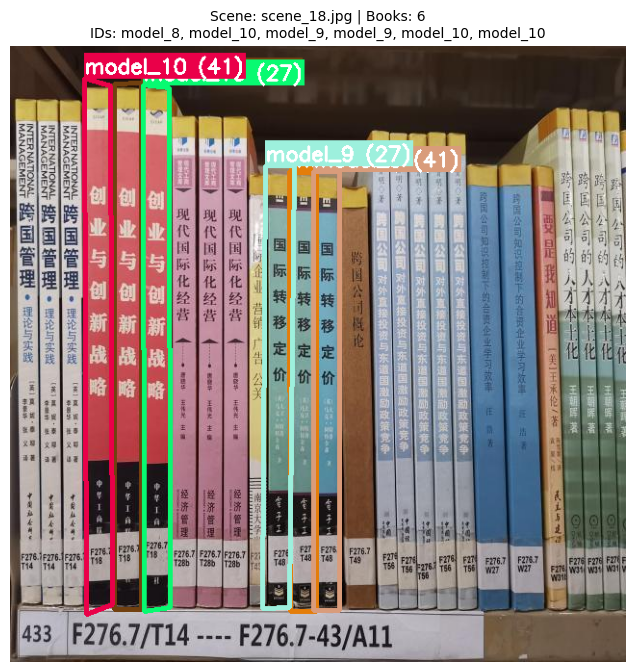


Processing: scene_19.jpg...
Iter 1: Trovato model_7 (89 inliers)
Iter 2: Trovato model_7 (69 inliers)
Iter 3: Trovato model_6 (59 inliers)


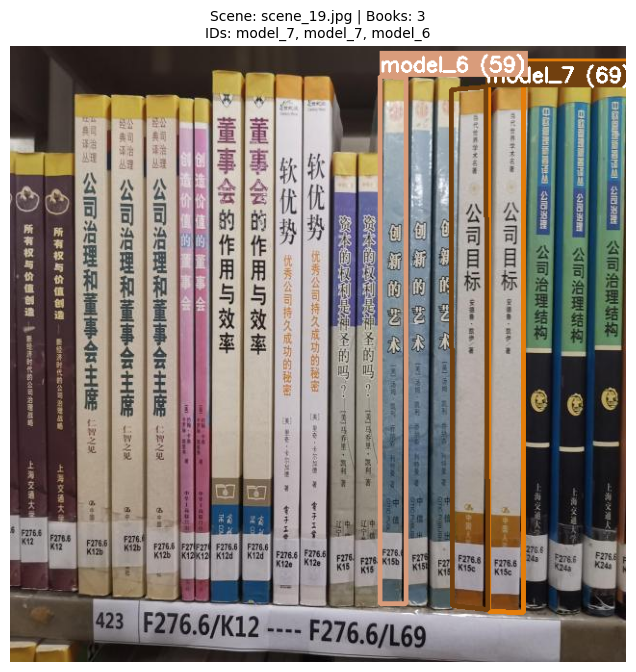


Processing: scene_2.jpg...
Iter 1: Trovato model_17 (84 inliers)


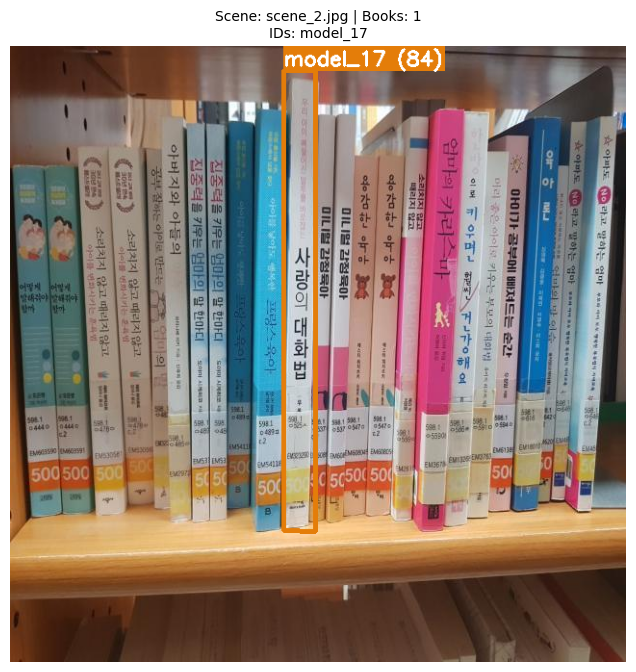


Processing: scene_20.jpg...


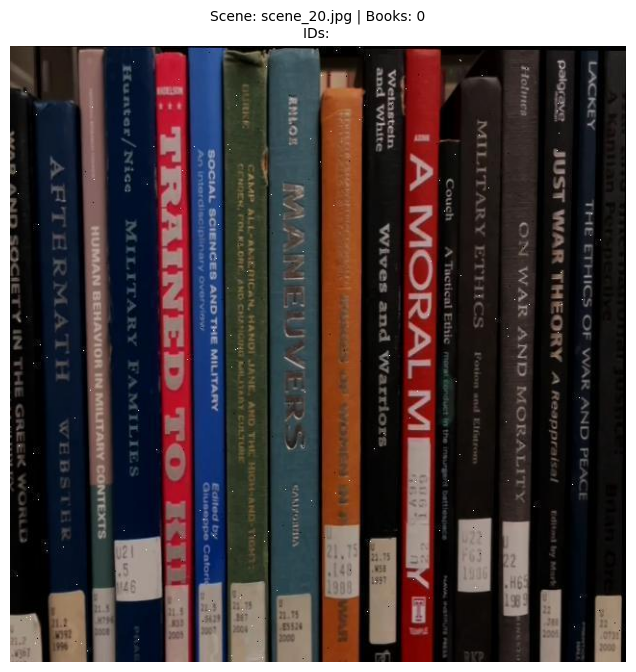


Processing: scene_21.jpg...


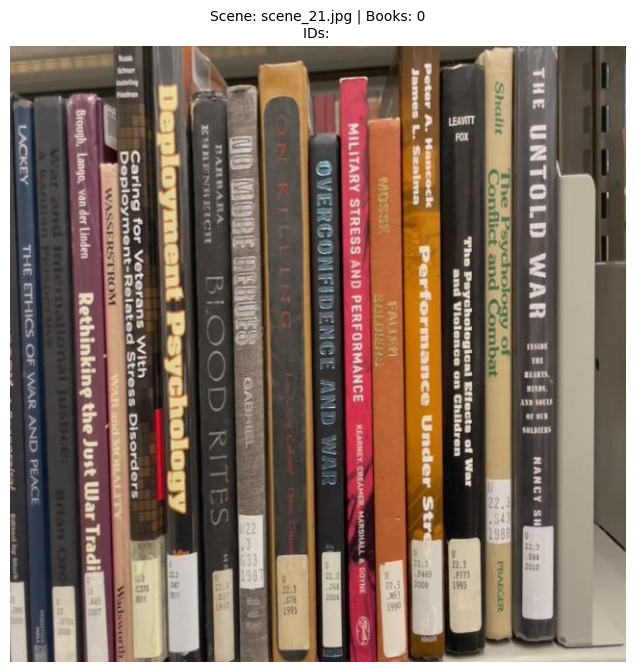


Processing: scene_22.jpg...


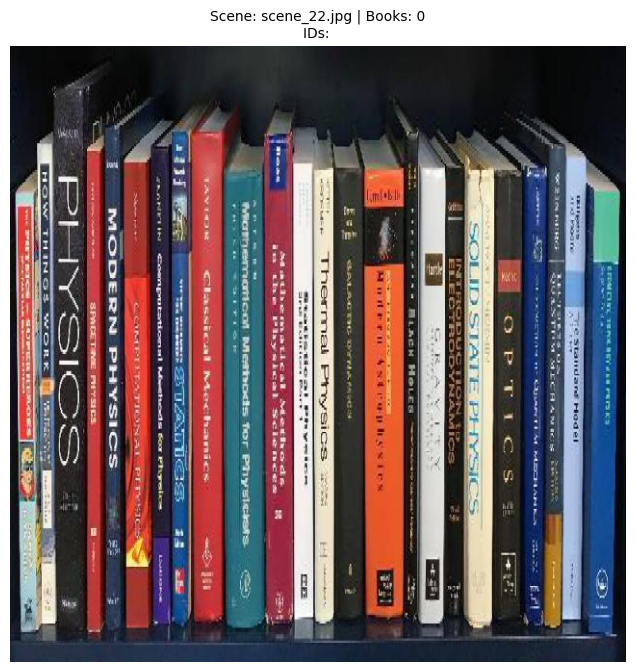


Processing: scene_23.jpg...
Iter 1: Trovato model_5 (177 inliers)


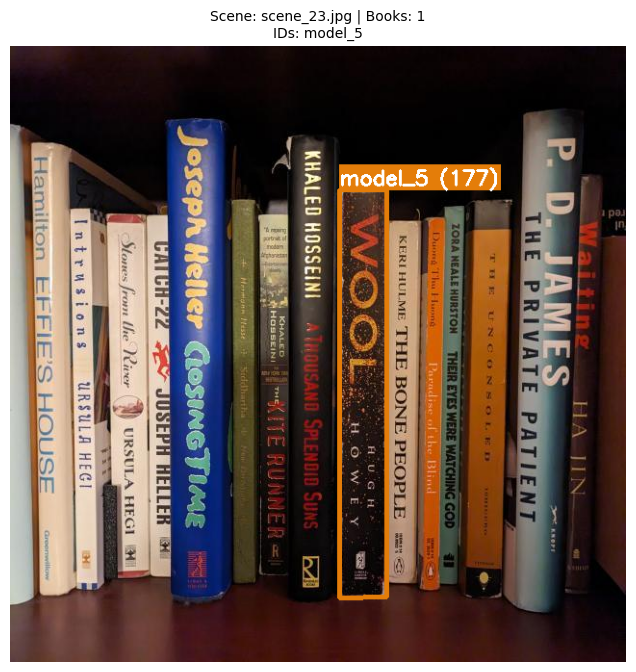


Processing: scene_24.jpg...


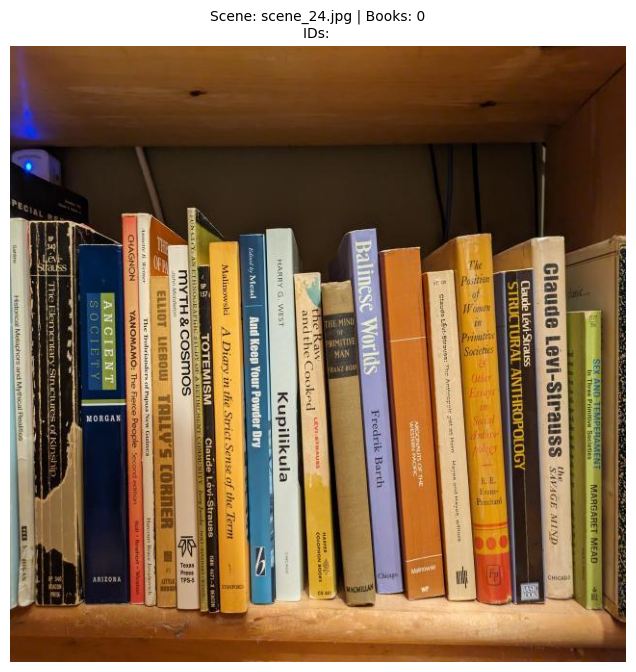


Processing: scene_25.jpg...


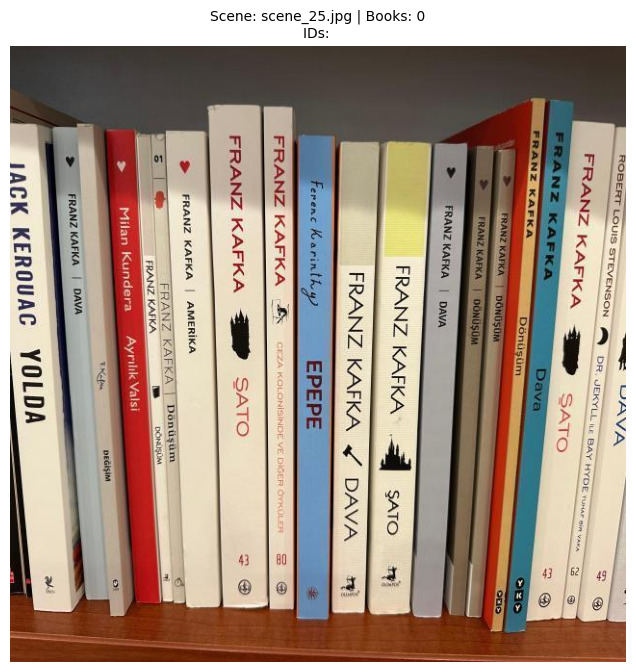


Processing: scene_26.jpg...
Iter 1: Trovato model_4 (425 inliers)
Iter 2: Trovato model_0 (52 inliers)
Iter 3: Trovato model_0 (38 inliers)


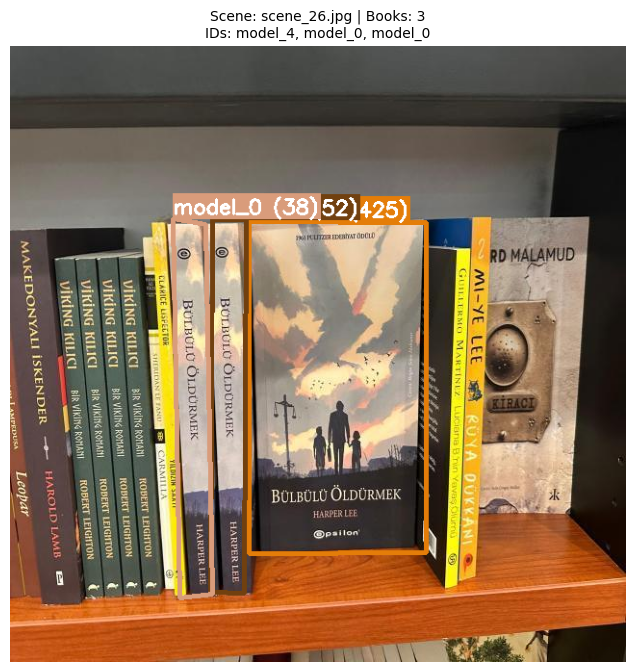


Processing: scene_27.jpg...
Iter 1: Trovato model_3 (97 inliers)
Iter 2: Trovato model_2 (68 inliers)


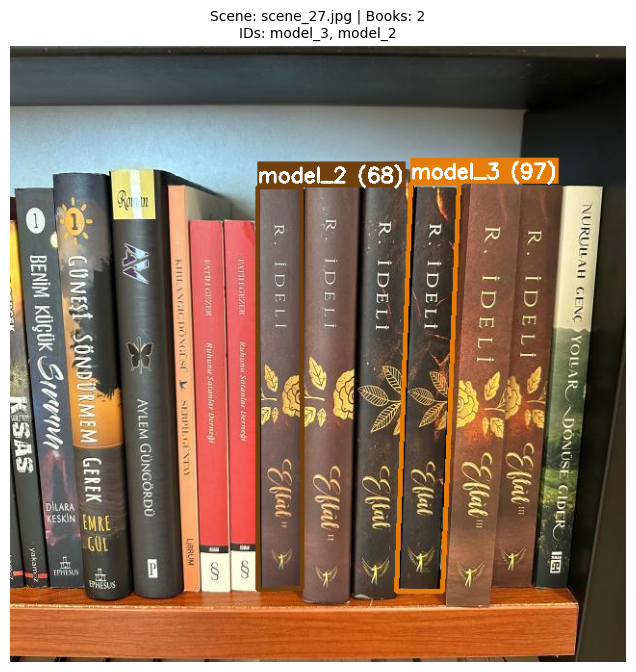


Processing: scene_28.jpg...
Iter 1: Trovato model_1 (61 inliers)
Iter 2: Trovato model_1 (49 inliers)


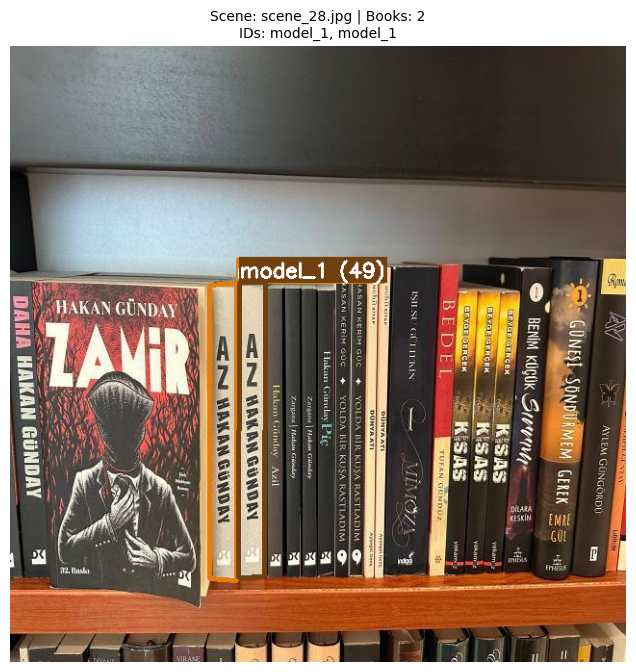


Processing: scene_3.jpg...
Iter 1: Trovato model_16 (80 inliers)
Iter 2: Trovato model_16 (36 inliers)


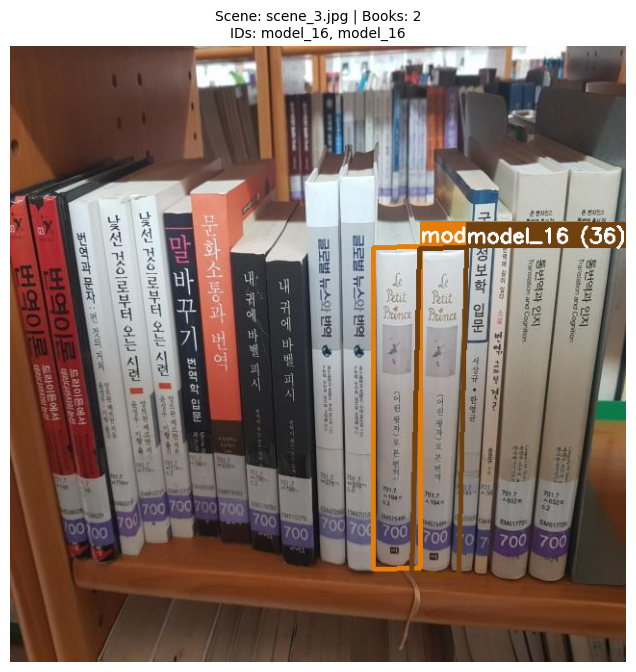


Processing: scene_300.jpg...
Iter 1: Trovato model_3 (100 inliers)
Iter 2: Trovato model_2 (71 inliers)


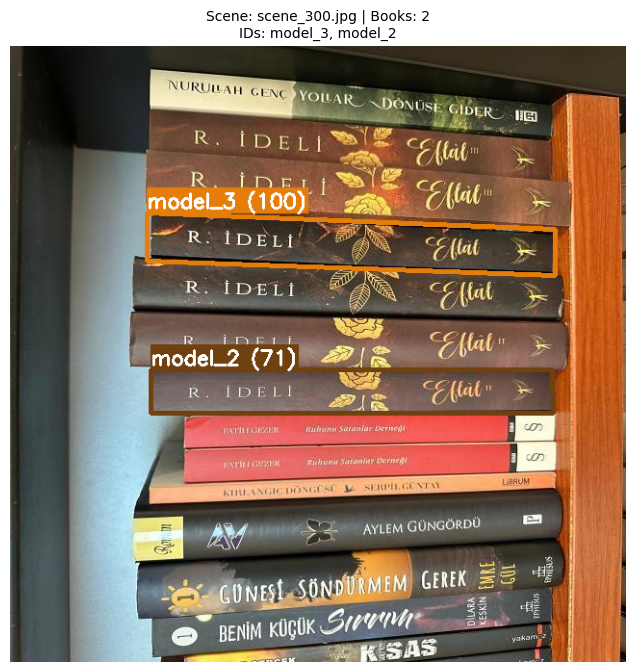


Processing: scene_4.jpg...
Iter 1: Trovato model_14 (214 inliers)
Iter 2: Trovato model_15 (119 inliers)
Iter 3: Trovato model_14 (104 inliers)
Iter 4: Trovato model_15 (103 inliers)


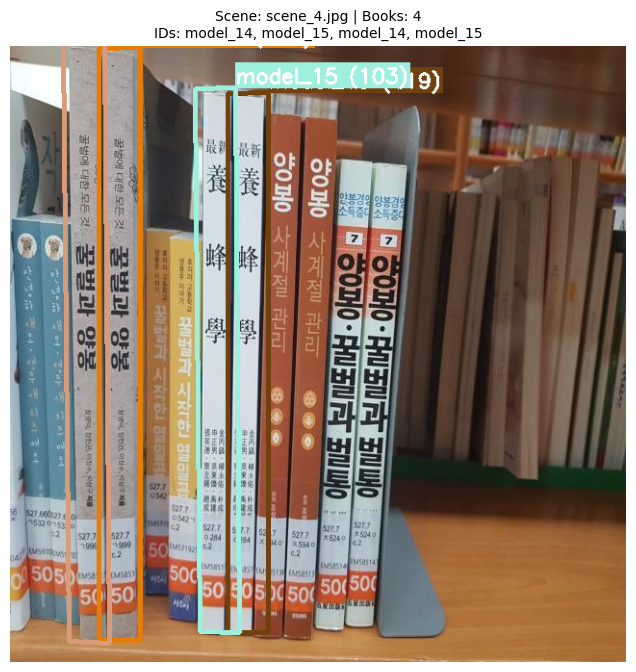


Processing: scene_5.jpg...
Iter 1: Trovato model_13 (158 inliers)


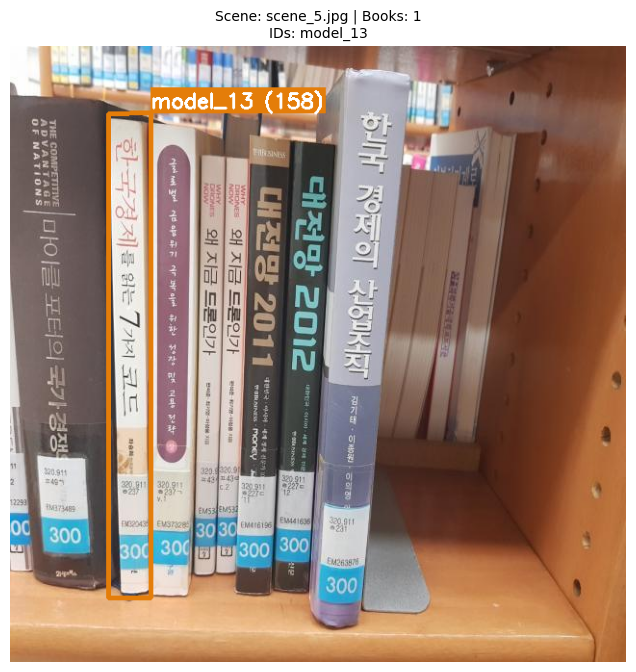


Processing: scene_6.jpg...
Iter 1: Trovato model_21 (216 inliers)


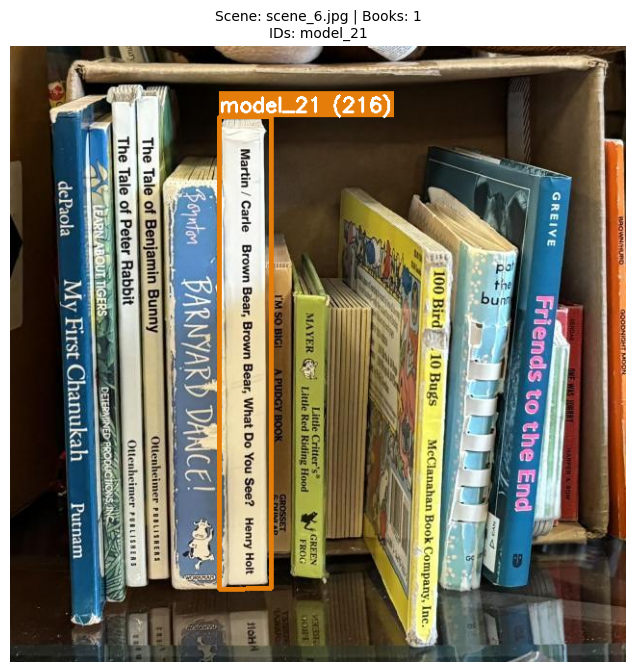


Processing: scene_7.jpg...
Iter 1: Trovato model_20 (161 inliers)
Iter 2: Trovato model_20 (127 inliers)


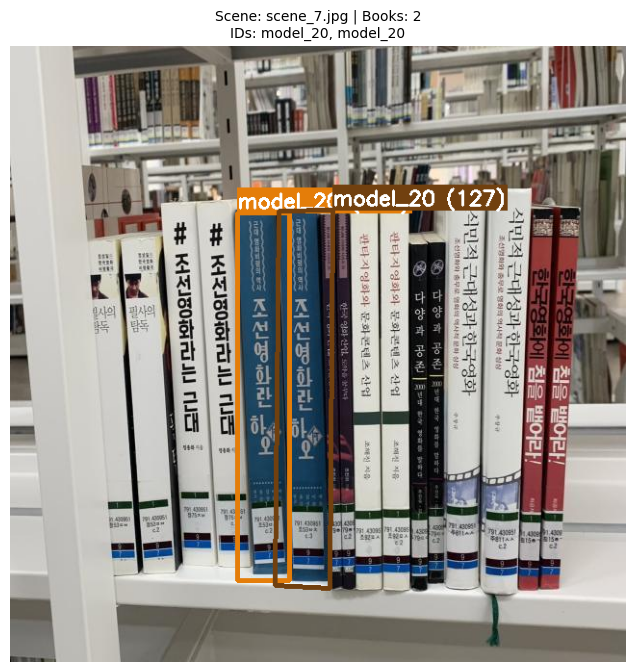


Processing: scene_8.jpg...


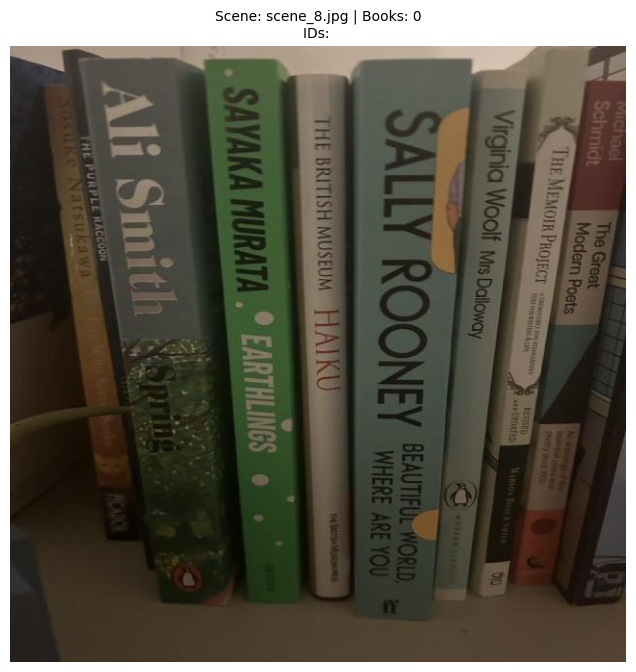


Processing: scene_9.jpg...


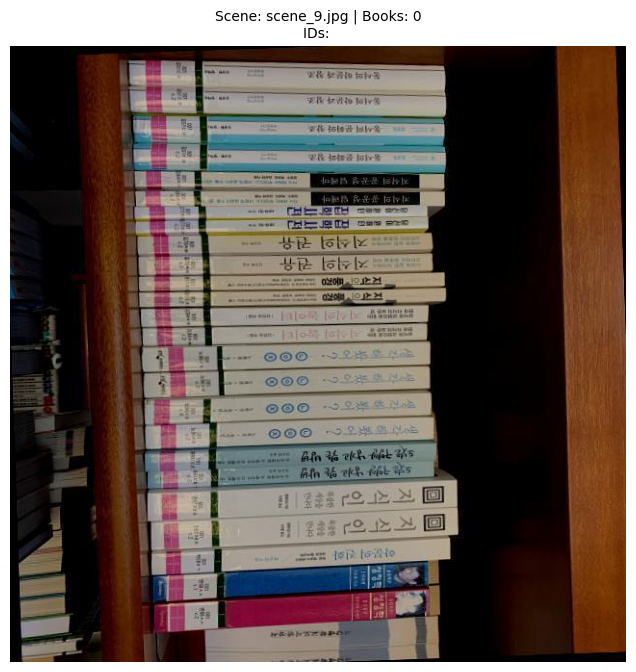


Processing Complete.


In [212]:
# --- MAIN EXECUTION ---

# 1. Setup
config = RecognitionConfig()
# (Assicurati che preprocessor, extractor, matcher siano istanziati correttamente con le tue classi precedenti)

recognizer = IterativeBookRecognizer(config=config)

# 2. Caricamento Modelli
models_dir = "./dataset/models/"
print(f"Loading models from {models_dir}...")
count = 0
for fname in os.listdir(models_dir):
    if fname.lower().endswith((".png", ".jpg", ".jpeg")):
        path = os.path.join(models_dir, fname)
        img = cv2.imread(path)
        if img is not None:
            book_id = os.path.splitext(fname)[0]
            recognizer.add_template(book_id, img)
            count += 1
print(f"✅ {count} Models loaded.")

# 3. Loop su Tutte le Scene
scenes_dir = "./dataset/scenes/"
scene_files = sorted([f for f in os.listdir(scenes_dir) if f.lower().endswith((".png", ".jpg", ".jpeg"))])

print(f"Found {len(scene_files)} scenes to process.")

for scene_file in scene_files:
    scene_path = os.path.join(scenes_dir, scene_file)
    print(f"\nProcessing: {scene_file}...")
    
    scene_img = cv2.imread(scene_path)
    if scene_img is None:
        print("Failed to load image.")
        continue

    # Esegui Riconoscimento
    # import time; t0 = time.time()
    results = recognizer.recognize(scene_img)
    # dt = time.time() - t0
    # print(f"Time: {dt:.2f}s - Found: {len(results)} books")

    # Visualizzazione Risultato
    vis_img = scene_img.copy()
    
    # Crea colori fissi o random per visualizzazione
    np.random.seed(10) 
    colors = np.random.randint(0, 255, (100, 3)).tolist()

    found_ids = []
    for i, res in enumerate(results):
        bbox = np.int32(res["bbox"])
        book_id = res["book_id"]
        score = res["score"]
        found_ids.append(book_id)
        
        color = colors[i % len(colors)]
        
        # Disegna Contorno Spesso
        cv2.polylines(vis_img, [bbox], True, color, 4)
        
        # Etichetta con sfondo (per leggere meglio)
        label = f"{book_id} ({score})"
        (w_text, h_text), _ = cv2.getTextSize(label, cv2.FONT_HERSHEY_SIMPLEX, 0.7, 2)
        
        # Trova il punto più in alto a sinistra del box
        pts = bbox.reshape(-1, 2)
        idx_top = np.argmin(pts[:, 1])
        x, y = pts[idx_top]
        
        # Rettangolo sfondo testo
        cv2.rectangle(vis_img, (x, y - h_text - 10), (x + w_text, y), color, -1)
        cv2.putText(vis_img, label, (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (255,255,255), 2)

    # Mostra con Matplotlib
    plt.figure(figsize=(12, 8))
    plt.imshow(cv2.cvtColor(vis_img, cv2.COLOR_BGR2RGB))
    plt.title(f"Scene: {scene_file} | Books: {len(results)}\nIDs: {', '.join(found_ids)}", fontsize=10)
    plt.axis('off')
    plt.show()

print("\nProcessing Complete.")